# <center> Text-to-Image Generation: A Comparative Analysis of Modern Techniques </center>

In [1]:
# Import necessary libraries
import os
os.environ['TF_USE_LEGACY_KERAS'] = 'True'
import gc
import time
import random
import json
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch

import tensorflow as tf
from tensorflow.keras.layers import Embedding, Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Reshape, Conv2DTranspose, Conv2D
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
from tensorflow.keras.applications import VGG16
from tensorflow.keras.callbacks import ModelCheckpoint

from diffusers import DiffusionPipeline

# Configure TensorFlow settings
tf.config.experimental.set_visible_devices([], 'GPU')

caption_model = SentenceTransformer("all-MiniLM-L6-v2")

/Users/yassinnawar/miniforge3/envs/amr/lib/python3.9/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
Transformers is only compatible with Keras 2, but you have explicitly set `TF_USE_LEGACY_KERAS` to `0`. This may result in unexpected behaviour or errors if Keras 3 objects are passed to Transformers models.
/Users/yassinnawar/miniforge3/envs/amr/lib/python3.9/site-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutp

## Chapter 3: Custom Model Development

### 3.3 Phase 2: Custom Model Development Overview

In this phase, we focus on the development and evaluation of custom models designed for text-to-image generation using a subset of the **MS COCO 2017** dataset. The two models developed in this phase differ in resolution and complexity: a simpler **64x64 model** and a more sophisticated **256x256 model**. These models aim to explore how textual descriptions can be transformed into coherent images, analyzing both low-resolution and high-resolution image generation under resource constraints.

We integrate several advanced techniques, such as **perceptual loss** and **attention mechanisms**, to improve the quality of the generated images and test their effectiveness compared to pre-trained models.

---

## 3.3.1 Custom 64x64 Model Development

The **64x64 model** was built with a simple architecture to align with the computational constraints of running on a local machine. This model was trained on 60% of the MS COCO dataset, with key checkpoints saved at various stages (epochs 1, 10, 50, and 80) to monitor performance improvements over time. The model uses dense layers to process text embeddings and a series of convolutional upsampling layers to transform them into a 64x64 RGB image.

Key architectural details:
- **Dense layers** process text embeddings, outputting a spatial representation.
- **Transpose convolution layers** progressively upsample this representation into a 64x64 image.
- **Perceptual loss**, computed using the VGG16 model, was integrated to encourage realistic textures and features.

This model provides a foundational look at how text-to-image models learn to generate coherent visuals from text prompts, balancing simplicity with functionality.

---

## 3.3.2 Custom 256x256 Model Development

The **256x256 model** builds on the 64x64 foundation but introduces several enhancements for higher-resolution image generation. In this model, we incorporate an **attention mechanism** to focus on relevant parts of the textual input, improving the contextual alignment of the generated images. Additionally, a **Feature Pyramid Network (FPN)** was added using a **ResNet101 backbone** to extract multi-scale features, enhancing the model's ability to capture fine details and improve image quality.

Key architectural details:
- **Dense layers** are used to process textual embeddings, which are reshaped into a spatial tensor.
- **Conv2DTranspose layers** handle the upsampling to 256x256 resolution.
- The **attention mechanism** improves image quality by focusing on key aspects of the text prompt.
- The **FPN** aids in multi-scale feature extraction, refining visual details.

This model was trained on a larger portion of the dataset (up to 20%) and integrates a **combined loss function** consisting of pixel-level accuracy (MSE), perceptual loss, and FPN loss, producing more realistic, contextually relevant images. The **Adam optimizer** with a tuned learning rate was used for training, achieving the best results compared to alternative optimization strategies.


In [2]:
# Paths to the image subset and the corresponding annotations
subset_images_dir = 'coco_subset/train2017'
subset_annotations_file = 'coco_subset/annotations/captions_train2017.json'

# Load the COCO annotations
with open(subset_annotations_file, 'r') as f:
    coco = json.load(f)

# Randomly select 60% of the annotations for training the 64x64 model
total_annotations = len(coco['annotations'])
sample_size = int(0.01 * total_annotations)
random_indices = np.random.choice(total_annotations, sample_size, replace=False)
sampled_annotations = [coco['annotations'][i] for i in random_indices]

# Create dictionaries for mapping image IDs to file paths and captions
image_id_to_caption = {}
image_id_to_file = {}

# Populate the dictionaries with the selected annotations
for annotation in sampled_annotations: 
    image_id = annotation['image_id']
    caption = annotation['caption']
    if image_id not in image_id_to_caption:
        image_id_to_caption[image_id] = []
    image_id_to_caption[image_id].append(caption)

# Filter and map images that correspond to the sampled annotations
for image in coco['images']:
    if image['id'] in image_id_to_caption:
        file_path = os.path.join(subset_images_dir, image['file_name'])
        if os.path.exists(file_path):  # Ensure the image file exists
            image_id_to_file[image['id']] = file_path

# Create lists of file paths and corresponding captions
file_paths = []
captions = []
for image_id, file_path in image_id_to_file.items():
    if image_id in image_id_to_caption:
        for caption in image_id_to_caption[image_id]:
            file_paths.append(file_path)
            captions.append(caption)

print(f"Sampled annotations: {len(sampled_annotations)}")
print(f"Filtered images: {len(file_paths)}")


Sampled annotations: 5917
Filtered images: 5917


In [3]:
def preview_images_with_captions(dataset, num_images=10):
    plt.figure(figsize=(15, 15))
    for i, (image_batch, caption_batch) in enumerate(dataset.take(1)):
      break

    for i in range(num_images):
      image = image_batch[i]
      caption = caption_batch[i]
      plt.subplot(5, 2, i + 1)
      plt.imshow(image.numpy())
      plt.title(caption.numpy().decode('utf-8'))
      plt.axis('off')

    plt.show()


In [5]:
# Convert lists to TensorFlow datasets
file_paths_dataset = tf.data.Dataset.from_tensor_slices(file_paths)
captions_dataset = tf.data.Dataset.from_tensor_slices(captions)

# Load and preprocess images
def load_and_preprocess_image(path):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)  # Ensure 3 channels (RGB)
    image = tf.image.resize(image, [64, 64])  # Resize to 28x28 pixels
    image /= 255.0  # Normalize to [0,1] range
    return image

# Apply preprocessing
images_dataset = file_paths_dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)

# Combine images and captions into a single dataset, NOTE THTA THIS DATASET IS OVERWRITTERN LATER WHEN WE USE EMBEDDING OF CAPTIONS INSTEAD OF THESE SEQEUNCES DIRECTLY
# ALSO ORDER IS REVERSED.

dataset = tf.data.Dataset.zip((images_dataset, captions_dataset))
dataset = dataset.shuffle(buffer_size=1000).batch(32).prefetch(tf.data.AUTOTUNE)


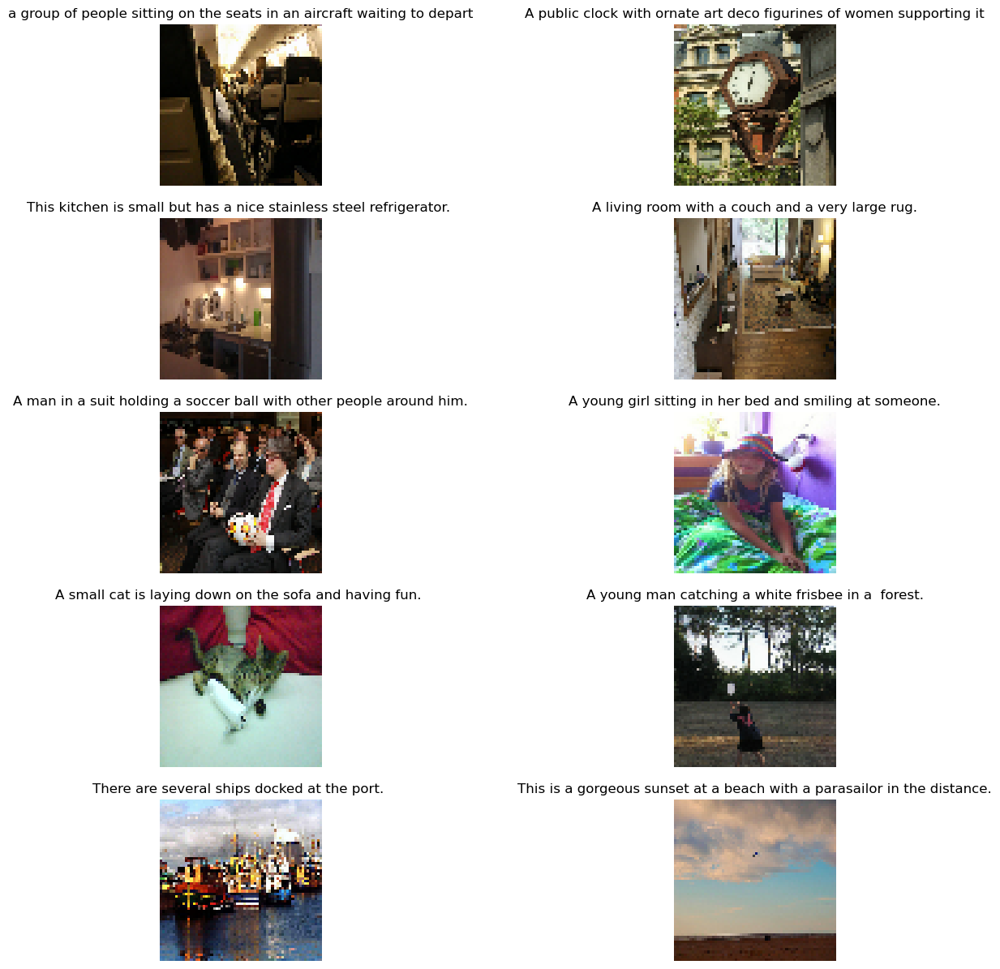

In [6]:
preview_images_with_captions(dataset, num_images=10)

In [7]:
caption_model.to('cpu')
caption_embeddings = caption_model.encode(captions)

In [8]:
captions_dataset = tf.data.Dataset.from_tensor_slices(caption_embeddings)
dataset = tf.data.Dataset.zip((captions_dataset, images_dataset))
with tf.device('/CPU:0'):
    dataset = dataset.shuffle(buffer_size=1000).batch(32).prefetch(tf.data.AUTOTUNE)

**64x64 Model**

In [9]:
from tensorflow.keras.models import Model
from tensorflow import keras

@keras.saving.register_keras_serializable()
class EnhancedCaptionToImageModel(Model):
    def __init__(self):
        super(EnhancedCaptionToImageModel, self).__init__()

        # Dense layers for processing the caption embeddings
        self.dense1 = Dense(1024, activation=None)
        self.batch_norm1 = BatchNormalization()
        self.leaky_relu1 = LeakyReLU(alpha=0.2)
        # Additional dense layers for more complex feature learning
        self.dense2 = Dense(16 * 16 * 256, activation=None)  # Output size increased to enhance feature learning
        self.batch_norm2 = BatchNormalization()
        self.leaky_relu2 = LeakyReLU(alpha=0.2)
        # Reshape the dense output into a 16x16x256 tensor
        self.reshape = Reshape((16, 16, 256))
        # Transpose convolution layers to upsample the output to 64x64x3 (RGB image)
        self.conv1 = Conv2DTranspose(128, (5, 5), strides=2, padding='same', activation='relu')  # Output: (32, 32, 128)
        self.batch_norm3 = BatchNormalization()
        self.conv2 = Conv2DTranspose(64, (5, 5), strides=2, padding='same', activation='relu')  # Output: (64, 64, 64)
        self.batch_norm4 = BatchNormalization()
        self.conv3 = Conv2DTranspose(32, (5, 5), strides=1, padding='same', activation='relu')  # Output: (64, 64, 32)
        # Final convolution layer to produce the output image (64x64x3)
        self.conv4 = Conv2D(3, (3, 3), strides=1, padding='same', activation='tanh')  # Final output: (64, 64, 3)

    def call(self, inputs):
        # Pass the input through dense and convolution layers with batch normalization and activation functions
        x = self.dense1(inputs)
        x = self.batch_norm1(x)
        x = self.leaky_relu1(x)
        x = self.dense2(x)
        x = self.batch_norm2(x)
        x = self.leaky_relu2(x)
        x = self.reshape(x)  # Reshape to (16, 16, 256)
        x = self.conv1(x)  # Upsample to (32, 32, 128)
        x = self.batch_norm3(x)
        x = self.conv2(x)  # Upsample to (64, 64, 64)
        x = self.batch_norm4(x)
        x = self.conv3(x)  # Output: (64, 64, 32)
        x = self.conv4(x)  # Final image output: (64, 64, 3)
        return x


# Load pre-trained VGG16 model for perceptual loss (using features from an intermediate layer)
def load_vgg_for_perceptual_loss():
    vgg = VGG16(weights='imagenet', include_top=False)
    vgg.trainable = False  # Freeze the VGG16 weights
    return Model(inputs=vgg.input, outputs=vgg.get_layer('block3_conv3').output)  # Use intermediate feature map


# Define the perceptual loss function based on VGG16 features
def perceptual_loss(y_true, y_pred, vgg_model):
    # Extract features of both real and generated images
    y_true_features = vgg_model(y_true)
    y_pred_features = vgg_model(y_pred)
    
    # Calculate mean squared error between the features
    return tf.reduce_mean(tf.square(y_true_features - y_pred_features))


# Define a custom callback to save the model at specific epochs
class SaveAtSpecificEpochs(tf.keras.callbacks.Callback):
    def __init__(self, save_epochs, save_dir):
        super(SaveAtSpecificEpochs, self).__init__()
        self.save_epochs = save_epochs
        self.save_dir = save_dir

    def on_epoch_end(self, epoch, logs=None):
        if epoch + 1 in self.save_epochs:
            save_path = f"{self.save_dir}/model_epoch_{epoch + 1}.keras"
            self.model.save(save_path)
            print(f"\nModel saved at {save_path}\n")


# Define model training parameters and settings
def train_model(dataset, save_dir='64x64_Models', epochs=100, save_epochs=[1, 10, 50, 80, 100]):
    # Initialize the simple model
    model = EnhancedCaptionToImageModel()

    # Load the VGG model for perceptual loss
    vgg_model = load_vgg_for_perceptual_loss()

    # Compile the model with Adam optimizer and perceptual loss
    model.compile(optimizer='adam', loss=lambda y_true, y_pred: perceptual_loss(y_true, y_pred, vgg_model))

    # Define callback for saving models at specific epochs
    save_callback = SaveAtSpecificEpochs(save_epochs=save_epochs, save_dir=save_dir)

    # Train the model with the dataset, using the callback to save models at specific epochs
    with tf.device('/GPU:0'):
        model.fit(dataset, epochs=epochs, callbacks=[save_callback])


In [ ]:
train_model(dataset)

- **Model Evaluation**: The saved checkpoints (epochs 1, 10, 50, and 80) will be loaded and evaluated based on the quality of the generated images. The progression of the model’s performance is observed as the training continues over multiple epochs:

    - **Epoch 1**: Early-stage training, where the generated images are expected to be of lower quality.
    - **Epoch 10**: Mid-training, where noticeable improvements in structure and texture are expected.
    - **Epoch 50**: Late-stage training, where the model is expected to generate more accurate and detailed images.
    - **Epoch 80**: Final-stage training, representing the best version of the 64x64 model in this phase.


In [10]:
import tensorflow as tf
from tensorflow import keras

# Use the `custom_objects` argument to register the custom loss function
model1 = tf.keras.models.load_model('64x64_model/model_epoch_1.tf', custom_objects={'perceptual_loss': perceptual_loss})
model2 = tf.keras.models.load_model('64x64_model/model_epoch_10.tf', custom_objects={'perceptual_loss': perceptual_loss})
model3 = tf.keras.models.load_model('64x64_model/model_epoch_50.tf', custom_objects={'perceptual_loss': perceptual_loss})
model4 = tf.keras.models.load_model('64x64_model/model_epoch_80.tf', custom_objects={'perceptual_loss': perceptual_loss})

# Store models in a list
Models = [model1, model2, model3, model4]
# Confirm that the models have been loaded successfully
for i, model in enumerate(Models, 1):
    print(f"Model {i} loaded successfully for inference.") 


Model 1 loaded successfully for inference.
Model 2 loaded successfully for inference.
Model 3 loaded successfully for inference.
Model 4 loaded successfully for inference.


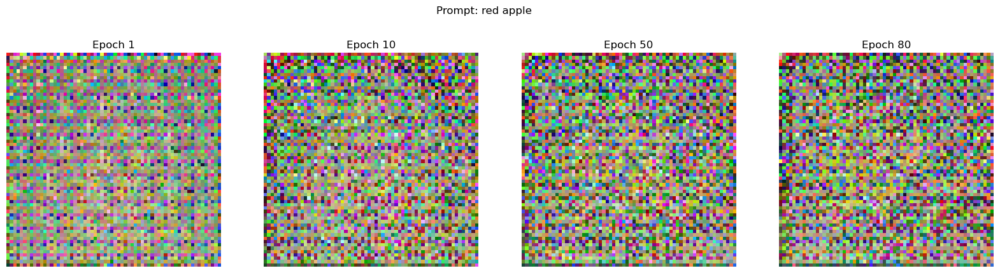

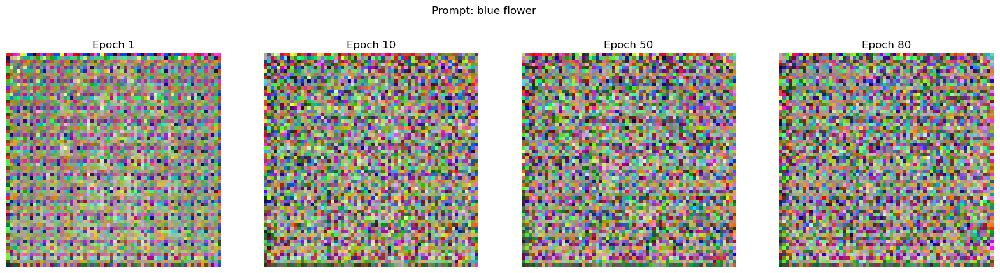

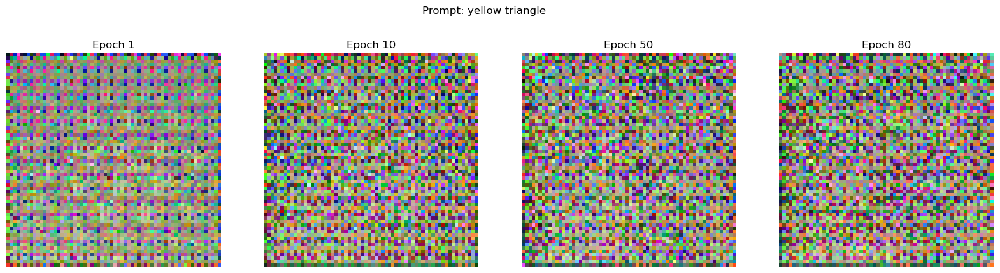

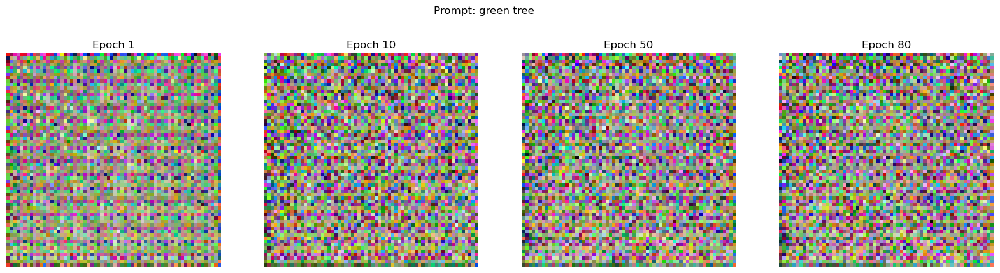

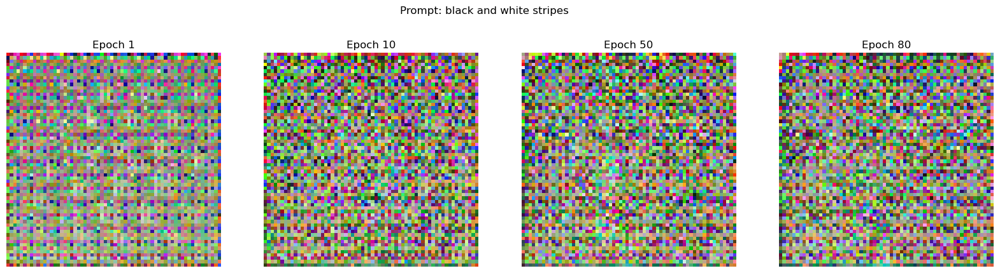

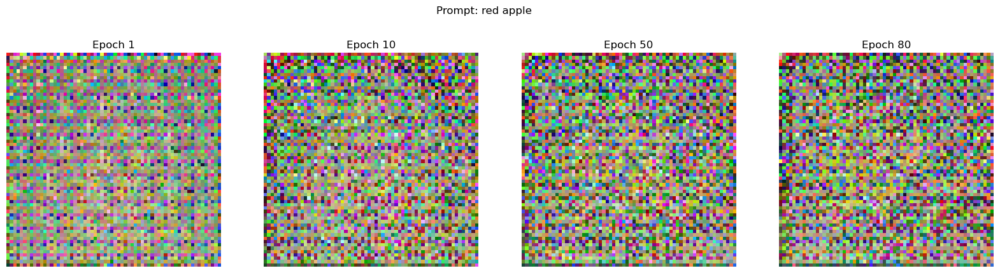

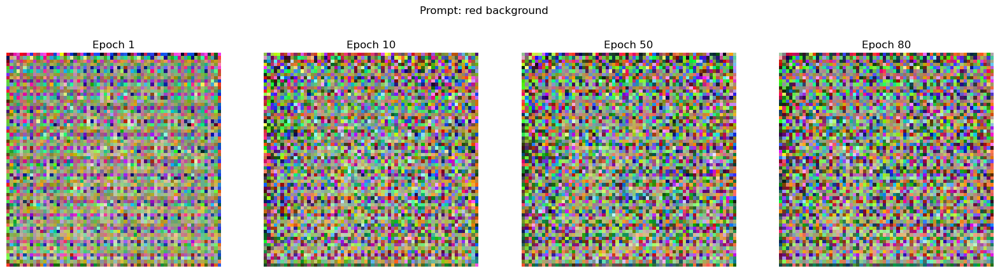

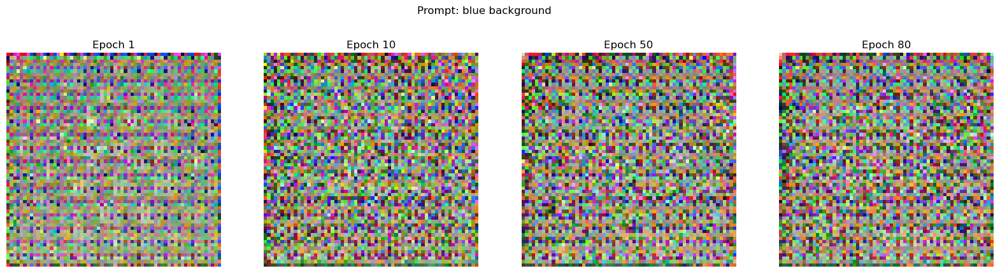

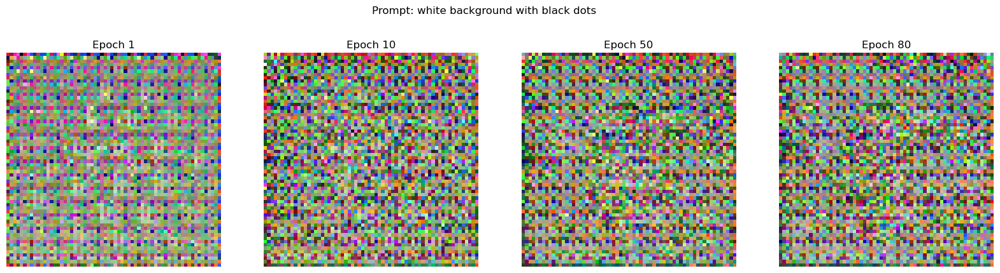

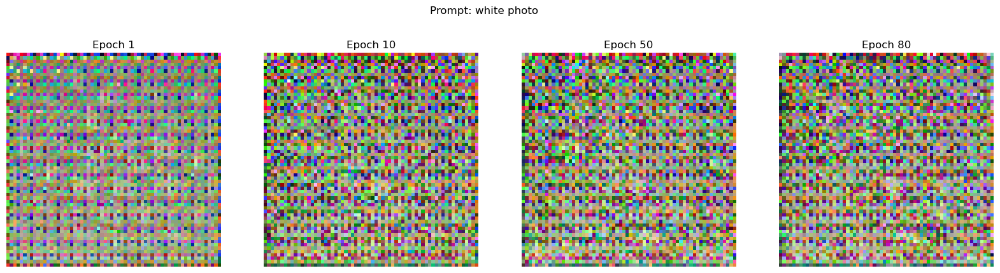

In [11]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# Assume your models are stored in this list
model_names = ['Epoch 1', 'Epoch 10', 'Epoch 50', 'Epoch 80']

# Preprocess the caption function
def preprocess_caption(caption):
    caption_sequence = caption_model.encode([caption])  # Assuming your caption_model encodes text
    return caption_sequence

# List of simple prompts for testing
test_prompts = [
    "red apple",
    "blue flower",
    "yellow triangle",
    "green tree",
    "black and white stripes",
    "red apple",
    "red background",
    "blue background",
    "white background with black dots",
    "white photo",
]

# Function to generate images from models and display them side by side
def generate_and_plot_images_for_prompt(prompt):
    plt.figure(figsize=(20, 5))  # Set the figure size to accommodate multiple images in one row
    
    for i, model in enumerate(Models):
        # Preprocess the prompt (caption)
        preprocessed_caption = preprocess_caption(prompt)
    
        # Generate an image from the preprocessed caption using inference with TFSMLayer
        generated_output = model(preprocessed_caption)  # Direct call for TFSMLayer
        
        # If the model's output is a dictionary, extract the image tensor (e.g., 'output_1')
        if isinstance(generated_output, dict):
            generated_image = generated_output['output_1']
        else:
            generated_image = generated_output
    
        # Remove batch dimension (if necessary)
        generated_image = tf.squeeze(generated_image, axis=0)  # Squeeze to remove extra batch dimension
    
        # Convert the generated image tensor to a format suitable for display
        generated_image = (generated_image * 255).numpy().astype(np.uint8)  # Convert to [0, 255] range and uint8 type
    
        # Display the generated image in a subplot
        plt.subplot(1, len(Models), i + 1)  # 1 row, len(Models) columns, i+1 is the index
        plt.imshow(generated_image)
        plt.title(f"{model_names[i]}")
        plt.axis('off')  # Hide axis labels
    
    plt.suptitle(f"Prompt: {prompt}")  # Add a common title for the prompt
    plt.show()  # Display the row of images

# Loop through each prompt and generate images from all models
for prompt in test_prompts:
    generate_and_plot_images_for_prompt(prompt)


## Evaluation of 64x64 Model Results

### Visual Analysis of the Generated Images

The images above represent the outputs generated by the custom 64x64 model at different stages of training: **Epoch 1**, **Epoch 10**, **Epoch 50**, and **Epoch 80** for two prompts: "blue background" and "white photo."

### Observations:

1. **Epoch 1**: 
   - The generated outputs at the first epoch appear as random noise. There is no discernible structure or form in the images, which is typical for the early stages of training as the model is just beginning to learn the mapping from text prompts to pixel data.

2. **Epoch 10**:
   - By epoch 10, the images still largely consist of random noise. There is a slight reduction in the randomness compared to epoch 1, but the model has not yet learned any meaningful features or structure from the input prompts. At this stage, the model is gradually learning to generate more cohesive pixel values, but it remains far from producing recognizable images.

3. **Epoch 50**:
   - In epoch 50, the outputs show marginal improvements in terms of pixel distributions, but the images still do not exhibit any discernible forms that relate to the prompts. This suggests that while the model is improving over time, it struggles to capture the semantic meaning of the input prompts with the limited dataset and resolution of 64x64.

4. **Epoch 80**:
   - Even after 80 epochs, the generated images remain mostly noise with no clear correlation to the text prompts ("blue background" or "white photo"). While some changes in color distributions can be noted, the model fails to produce coherent or meaningful images. This indicates a potential issue with the model architecture or the complexity of the task, which requires additional improvements in either the training process or model design.

### Conclusion:
The custom 64x64 model, after 80 epochs of training, has not been able to produce coherent images corresponding to the provided prompts. The outputs remain noisy and lack structure. This outcome suggests that either the model requires more training time, better architectural enhancements (such as attention mechanisms), or larger, more diverse datasets to learn from. Additionally, the limited resolution of 64x64 pixels may constrain the model's ability to generate detailed or contextually accurate images.


**256x256 Model**

In [2]:
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Reshape, Conv2DTranspose, Attention, LayerNormalization
from tensorflow.keras.applications import ResNet101
from tensorflow.keras.models import Model
import tensorflow as tf

class EnhancedCaptionToImageModel(Model):
    def __init__(self, img_shape, max_seq_length):
        super(EnhancedCaptionToImageModel, self).__init__()
        self.dense1 = Dense(1024, activation=None)  # Increased size of dense layer
        self.batch_norm1 = BatchNormalization()
        self.leaky_relu1 = LeakyReLU(alpha=0.2)
        self.dense2 = Dense(16 * 16 * 256, activation=None)  # Increased size before reshaping
        self.batch_norm2 = BatchNormalization()
        self.leaky_relu2 = LeakyReLU(alpha=0.2)
        self.reshape = Reshape((16, 16, 256))  # Reshape to a larger intermediate size

        # Transpose convolution layers to upsample to the final output size
        self.conv1 = Conv2DTranspose(256, (5, 5), strides=2, padding='same', activation='relu')  # Output: (32, 32, 256)
        self.batch_norm3 = BatchNormalization()
        self.conv2 = Conv2DTranspose(128, (5, 5), strides=2, padding='same', activation='relu')  # Output: (64, 64, 128)
        self.batch_norm4 = BatchNormalization()
        self.conv3 = Conv2DTranspose(64, (5, 5), strides=2, padding='same', activation='relu')   # Output: (128, 128, 64)
        self.batch_norm5 = BatchNormalization()
        self.conv4 = Conv2DTranspose(32, (5, 5), strides=2, padding='same', activation='relu')   # Output: (256, 256, 32)
        self.conv5 = Conv2DTranspose(3, (5, 5), strides=1, padding='same', activation='sigmoid')  # Final output: (256, 256, 3)

    def call(self, x):
        x = self.dense1(x)
        x = self.batch_norm1(x)
        x = self.leaky_relu1(x)
        x = self.dense2(x)
        x = self.batch_norm2(x)
        x = self.leaky_relu2(x)
        x = self.reshape(x)  # Reshape to (16, 16, 256)

        x = self.conv1(x)  # Upsample to (32, 32, 256)
        x = self.batch_norm3(x)
        x = self.conv2(x)  # Upsample to (64, 64, 128)
        x = self.batch_norm4(x)
        x = self.conv3(x)  # Upsample to (128, 128, 64)
        x = self.batch_norm5(x)
        x = self.conv4(x)  # Upsample to (256, 256, 32)
        x = self.conv5(x)  # Output layer to get the final image (256, 256, 3)

        return x

# Step 2: Attention Mechanism (Add self-attention before or after the main model call)
class EnhancedCaptionToImageWithAttention(Model):
    def __init__(self, base_model):
        super(EnhancedCaptionToImageWithAttention, self).__init__()
        self.base_model = base_model
        self.attention_layer = Attention()
        self.layer_norm = LayerNormalization()

    def call(self, x):
        # Forward pass through the base model (your custom model)
        generated_image = self.base_model(x)

        # Applying self-attention to the generated image
        attention_output = self.attention_layer([generated_image, generated_image])
        attention_output = self.layer_norm(attention_output + generated_image)  # Residual connection

        return attention_output
        
    def get_config(self):
        # Return a dictionary to serialize the model
        config = super(EnhancedCaptionToImageWithAttention, self).get_config()
        return config

    @classmethod
    def from_config(cls, config, custom_objects=None):
        # Recreate the base model manually during deserialization
        base_model = EnhancedCaptionToImageModel(img_shape=(256, 256, 3), max_seq_length=20)
        return cls(base_model=base_model)

# Instantiate the base model and the attention-augmented model
base_model = EnhancedCaptionToImageModel(img_shape=(256, 256, 3), max_seq_length=20)
model_with_attention = EnhancedCaptionToImageWithAttention(base_model)

# Step 3: Feature Pyramid Network (FPN) for Multi-scale Feature Extraction with ResNet101
# Load ResNet101 for multi-scale feature extraction (FPN-style)
resnet_fpn = ResNet101(weights='imagenet', include_top=False, input_shape=(256, 256, 3))
resnet_fpn.trainable = False  # Freeze the ResNet101 model weights

# Extract features at multiple levels
layer_names = ['conv2_block3_out', 'conv3_block4_out', 'conv4_block23_out']  # Layers at different scales
multi_scale_outputs = [resnet_fpn.get_layer(layer_name).output for layer_name in layer_names]

# Define an FPN-like model that outputs features at different scales
fpn_model = Model(inputs=resnet_fpn.input, outputs=multi_scale_outputs)

# Define the FPN loss function (computes loss across multiple scales)
def fpn_loss(y_true, y_pred):
    # Extract multi-scale features from true and predicted images
    y_true_features = fpn_model(y_true)
    y_pred_features = fpn_model(y_pred)

    # Compute the loss across different scales
    loss = 0
    for true_feat, pred_feat in zip(y_true_features, y_pred_features):
        loss += tf.reduce_mean(tf.square(true_feat - pred_feat))  # MSE loss for each scale

    return loss

# Step 4: Combine FPN loss and perceptual loss with MSE
def combined_loss_with_fpn_and_attention(y_true, y_pred):
    # MSE loss
    mse_loss = tf.reduce_mean(tf.square(y_true - y_pred))

    # FPN loss (multi-scale loss)
    fpn_loss_value = fpn_loss(y_true, y_pred)

    # Combine the losses 
    return mse_loss + 0.7 * fpn_loss_value  # scaling factor for FPN loss

# Step 5: Compile the model
model_with_attention.compile(optimizer='adam', loss=combined_loss_with_fpn_and_attention)
# model_with_attention.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss=combined_loss_with_fpn_and_attention)



In [ ]:
model_with_attention.compile(optimizer='adam', loss=combined_loss_with_fpn_and_attention)

# Train the model
with tf.device('/GPU:0'):
    history = model_with_attention.fit(dataset, epochs=100)

# Save the model to your desktop with a descriptive name
save_path = os.path.expanduser("~/Desktop/model_adam_lr1e-3_resnet_fpn7.keras")
model_with_attention.save(save_path)
print(f"Model saved to {save_path}")

In [3]:
model_path1 = '256_Models/trained_model_256x256_0.2_50_epochs.keras'
model_path2 = '256_Models/model_rmsprop_lr1e-4.keras'
model_path3 = '256_Models/model_adam_lr1e-2.keras'
model_path4 = '256_Models/model_adam_lr1e-3.keras'
model_path5 = '256_Models/model_adam_lr1e-4.keras'
model_path6 = '256_Models/model_adam_resnet+.keras'
model_path7 = '256_Models/model_adam_lr1e-2_resnet+.keras'
model_path8 = '256_Models/model_adam_lr1e-3_resnet+.keras'
model_path9 = '256_Models/model_adam_lr1e-4_resnet+.keras'


MediumModel = tf.keras.models.load_model(model_path1, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
RMSModel_4 = tf.keras.models.load_model(model_path2, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
AdamModel_2 = tf.keras.models.load_model(model_path3, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
AdamModel_3 = tf.keras.models.load_model(model_path4, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
AdamModel_4 = tf.keras.models.load_model(model_path5, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
Resnet_Attn_FPN = tf.keras.models.load_model(model_path6, custom_objects={
    'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel,
    'EnhancedCaptionToImageWithAttention': EnhancedCaptionToImageWithAttention,
    'combined_loss_with_fpn_and_attention': combined_loss_with_fpn_and_attention
},compile=False)
Resnet_Attn_FPN_2 = tf.keras.models.load_model(model_path7, custom_objects={
    'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel,
    'EnhancedCaptionToImageWithAttention': EnhancedCaptionToImageWithAttention,
    'combined_loss_with_fpn_and_attention': combined_loss_with_fpn_and_attention
},compile=False)
Resnet_Attn_FPN_3 = tf.keras.models.load_model(model_path8, custom_objects={
    'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel,
    'EnhancedCaptionToImageWithAttention': EnhancedCaptionToImageWithAttention,
    'combined_loss_with_fpn_and_attention': combined_loss_with_fpn_and_attention
},compile=False)
Resnet_Attn_FPN_4 = tf.keras.models.load_model(model_path9, custom_objects={
    'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel,
    'EnhancedCaptionToImageWithAttention': EnhancedCaptionToImageWithAttention,
    'combined_loss_with_fpn_and_attention': combined_loss_with_fpn_and_attention
},compile=False)

In [4]:
Models = []
Models.append(RMSModel_4)
Models.append(AdamModel_2)
Models.append(AdamModel_3)
Models.append(AdamModel_4)
Models.append(Resnet_Attn_FPN)
Models.append(Resnet_Attn_FPN_2)
Models.append(Resnet_Attn_FPN_3)
Models.append(Resnet_Attn_FPN_4)
Models.append(MediumModel)

print(len(Models))

9


1/1 [==============================] - 0s 155ms/step


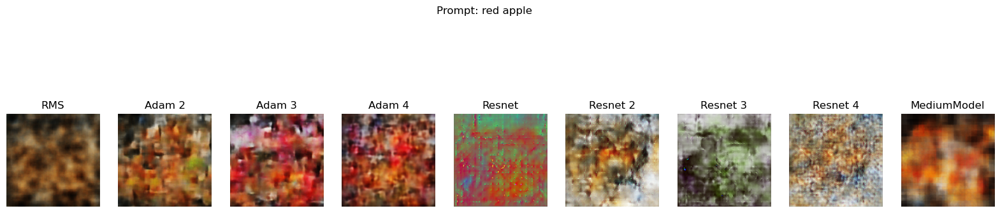

1/1 [==============================] - 0s 46ms/step


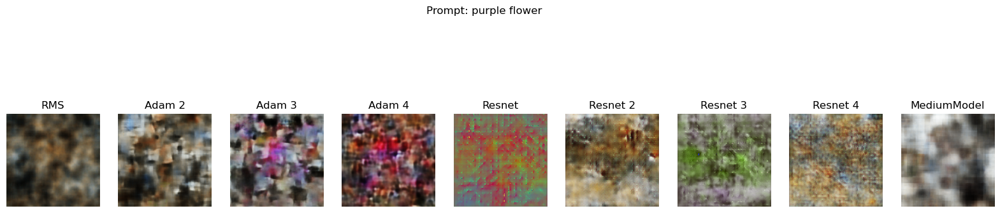

1/1 [==============================] - 0s 45ms/step


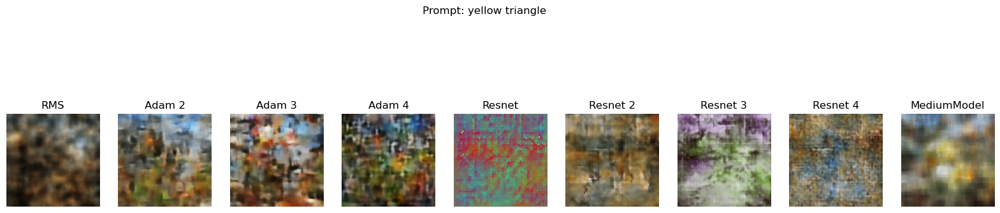

1/1 [==============================] - 0s 46ms/step


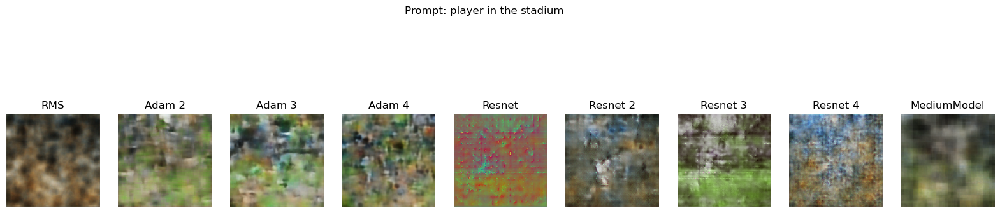

1/1 [==============================] - 0s 46ms/step


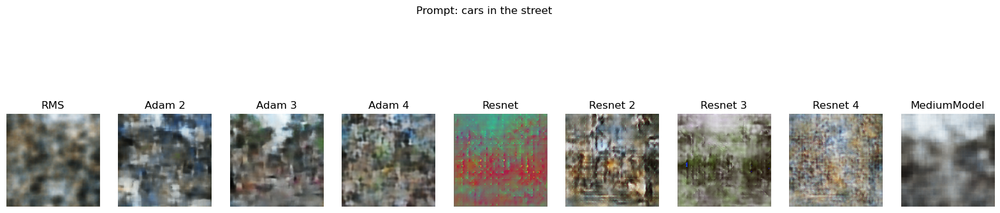

1/1 [==============================] - 0s 48ms/step


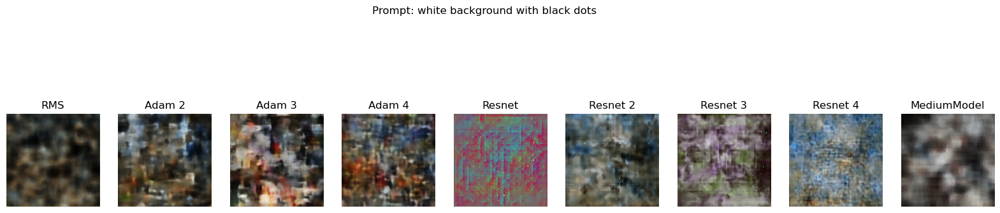

1/1 [==============================] - 0s 47ms/step


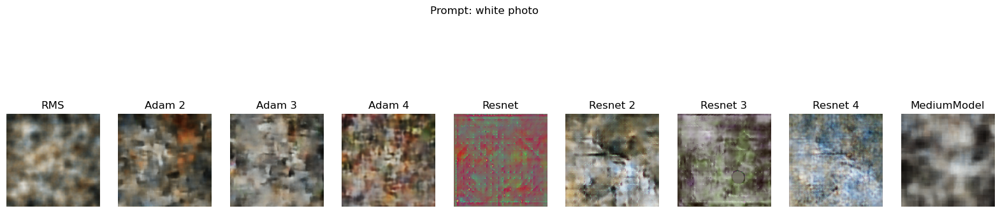

1/1 [==============================] - 0s 46ms/step


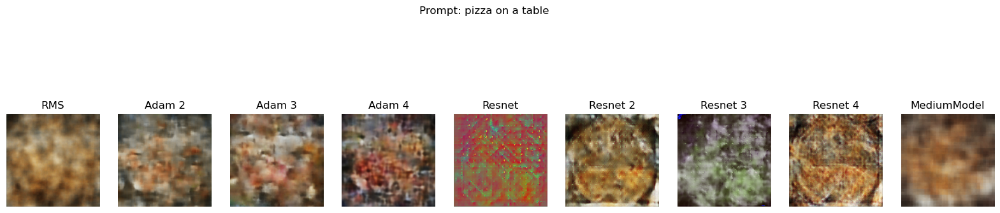

1/1 [==============================] - 0s 46ms/step


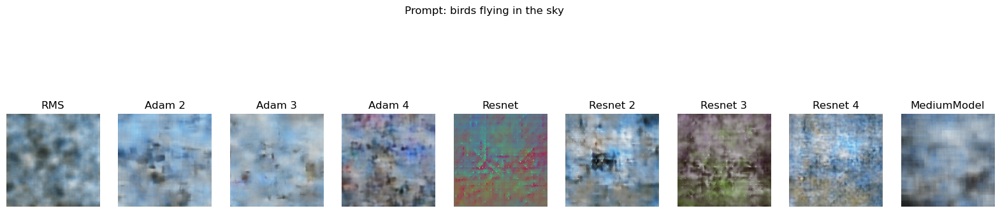

1/1 [==============================] - 0s 47ms/step


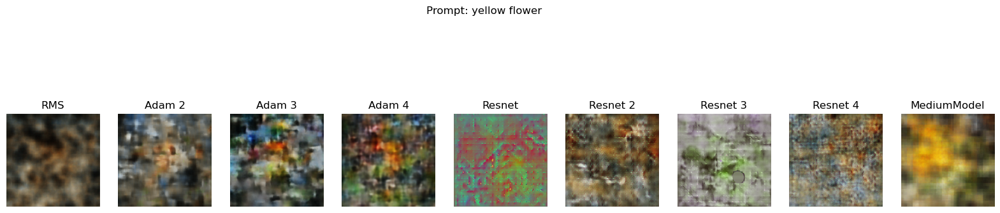

1/1 [==============================] - 0s 48ms/step


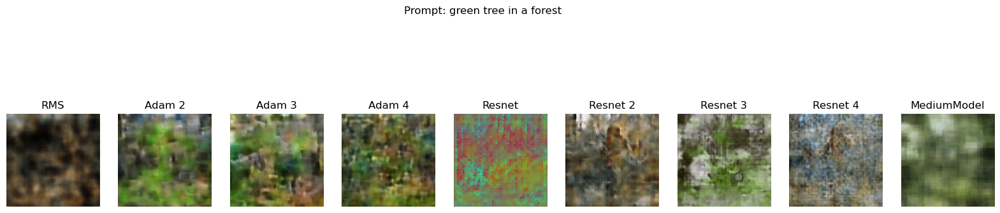

1/1 [==============================] - 0s 49ms/step


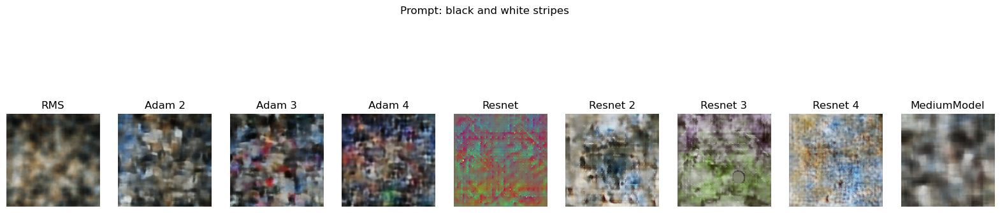

1/1 [==============================] - 0s 47ms/step


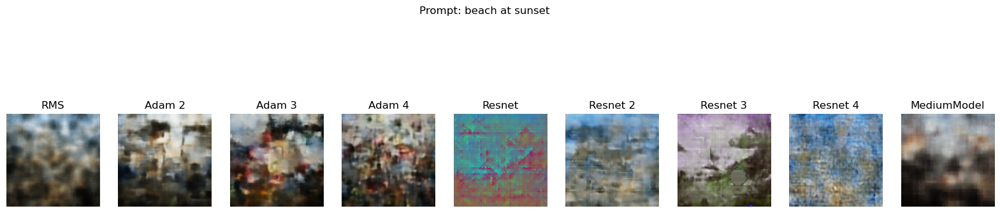

1/1 [==============================] - 0s 48ms/step


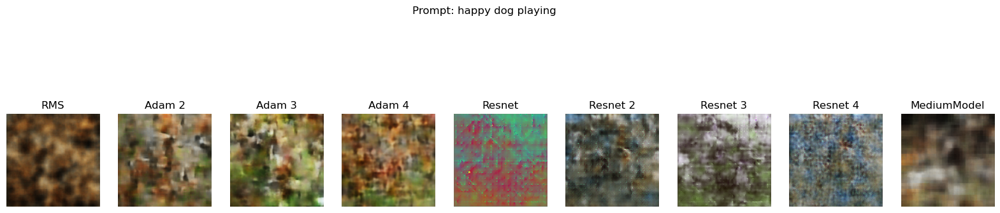

1/1 [==============================] - 0s 46ms/step


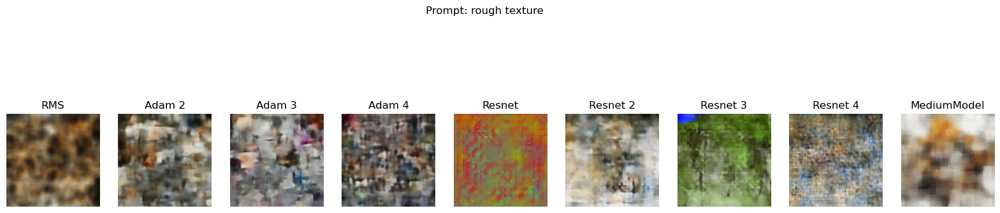

1/1 [==============================] - 0s 48ms/step


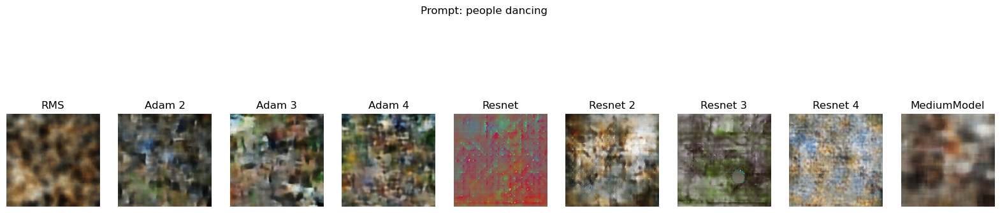

1/1 [==============================] - 0s 49ms/step


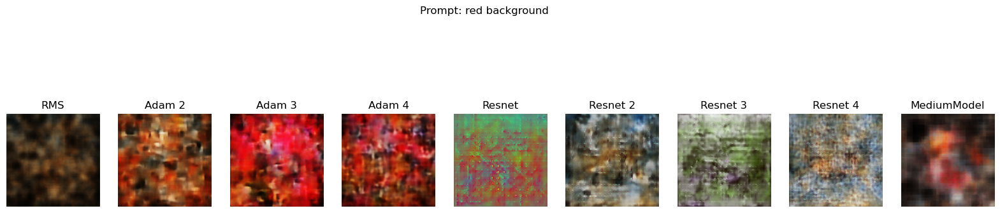

1/1 [==============================] - 0s 45ms/step


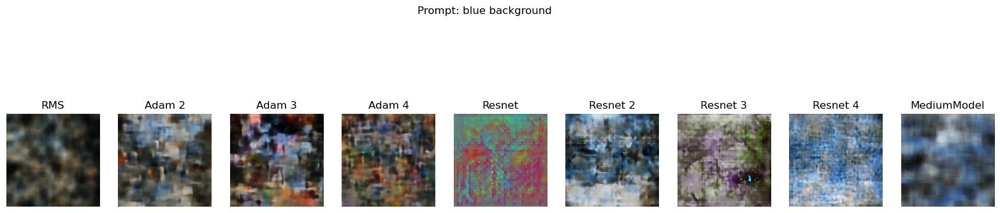

1/1 [==============================] - 0s 46ms/step


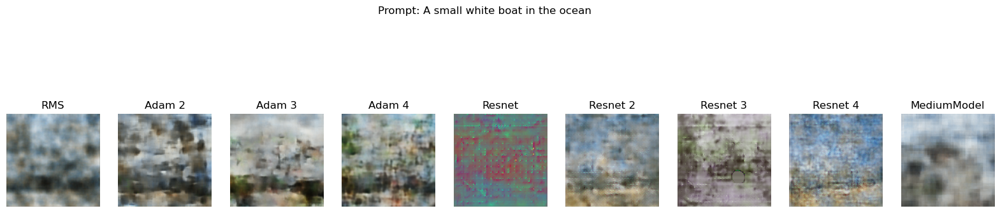

1/1 [==============================] - 0s 45ms/step


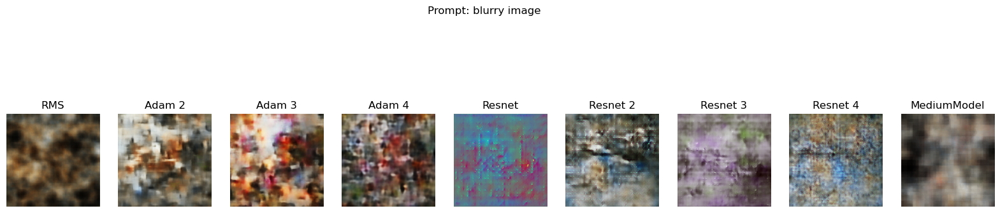

1/1 [==============================] - 0s 51ms/step


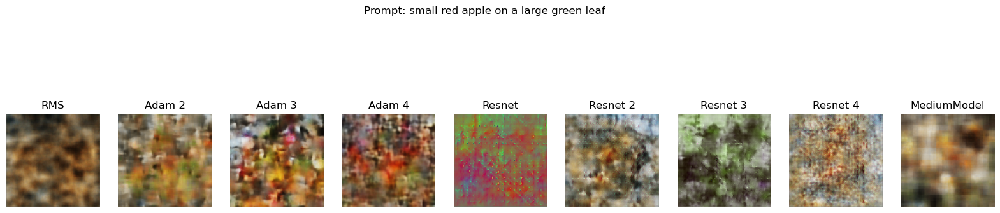

1/1 [==============================] - 0s 46ms/step


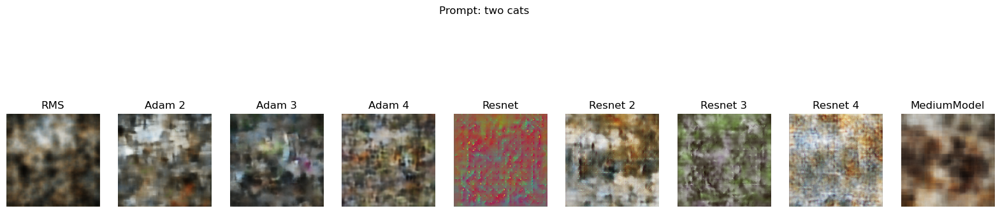

1/1 [==============================] - 0s 48ms/step


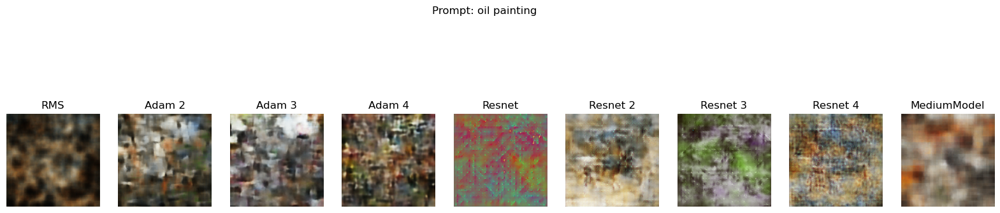

1/1 [==============================] - 0s 48ms/step


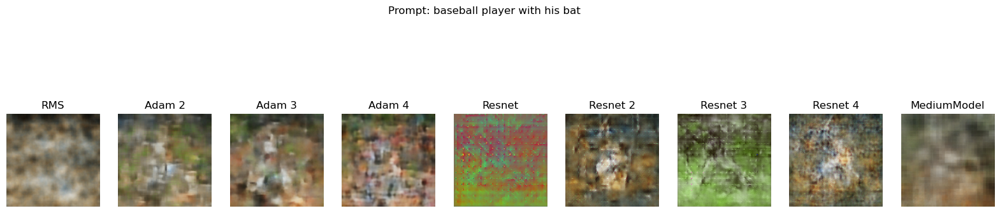

1/1 [==============================] - 0s 49ms/step


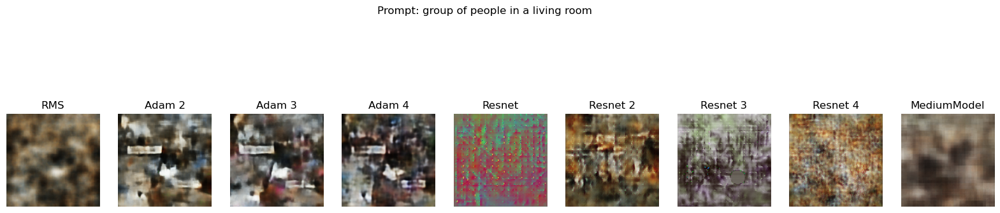

In [11]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# Assume your models are stored in this list
# Models = [model1, model2, model3, model4, model5]  # Replace these with your actual model variables
model_names = ['RMS', 'Adam 2', 'Adam 3', 'Adam 4', 'Resnet', 'Resnet 2','Resnet 3','Resnet 4','MediumModel']

# Preprocess the caption function
def preprocess_caption(caption):
    caption_sequence = caption_model.encode([caption])  # Assuming your caption_model encodes text
    return caption_sequence

# List of simple prompts for testing
test_prompts = [
    "red apple",
    "purple flower",
    "yellow triangle",
    "player in the stadium",
    "cars in the street",
    "white background with black dots",
    "white photo",
    "pizza on a table",
    "birds flying in the sky",
    "yellow flower",
    "green tree in a forest ",
    "black and white stripes",
    "beach at sunset",
    "happy dog playing",
    "rough texture",
    "people dancing",
    "red background",
    "blue background",
    "A small white boat in the ocean",
    "blurry image",
    "small red apple on a large green leaf",
    "two cats",
    "oil painting",
    "baseball player with his bat",
    "group of people in a living room"   
]

# Function to generate images from models and display them side by side
def generate_and_plot_images_for_prompt(prompt):
    plt.figure(figsize=(20, 5))  # Set the figure size to accommodate multiple images in one row

    
    for i, model in enumerate(Models):
        # Preprocess the prompt (caption)
        preprocessed_caption = preprocess_caption(prompt)
    
        # Generate an image from the preprocessed caption
        generated_image = model.predict(preprocessed_caption)
    
        # Remove batch dimension (if necessary)
        generated_image = tf.squeeze(generated_image, axis=0)  # Shape should be (28, 28, 3) or appropriate
    
        # Convert the generated image tensor to a format suitable for display
        generated_image = (generated_image * 255).numpy().astype(np.uint8)  # Convert to [0, 255] range and uint8 type
    
        # Display the generated image in a subplot
        plt.subplot(1, len(Models), i + 1)  # 1 row, len(Models) columns, i+1 is the index
        plt.imshow(generated_image)
        plt.title(f"{model_names[i]}")
        plt.axis('off')  # Hide axis labels
    
    plt.suptitle(f"Prompt: {prompt}")  # Add a common title for the prompt
    plt.show()  # Display the row of images

# Loop through each prompt and generate images from all models
for prompt in test_prompts:
    generate_and_plot_images_for_prompt(prompt)


# Experiment: Evaluating Optimizer and Model Variations for Text-to-Image Generation

In this experiment, I explored multiple model configurations and optimizer variations to generate images from text prompts using a subset of the MS COCO dataset. The objective was to assess which combination of architecture and optimizer could produce the most coherent, high-quality images based on human visual evaluation.

---

### Dataset Details
- **Training Data**: Most models were trained on 600 images, which is approximately 0.5% of the total dataset.
- **MediumModel**: Initially trained on 20% of the dataset for 50 epochs. Currently being trained again for further evaluation.

---

### Model Configurations
The following models and optimizers were tested during this phase of the experiment:
- **RMS**: Root Mean Square Propagation optimizer.
- **Adam-based Models**: Variations of the Adam optimizer, including Adam 2, Adam 3, and Adam 4.
- **ResNet Variants**: Standard ResNet architecture with several configurations (ResNet, ResNet 2, ResNet 3, ResNet 4).
- **MediumModel**: A custom model combining various architecture and optimizer elements (currently in progress with further training).

---

### Human Evaluation
Since traditional metrics like CLIPScore and Inception Score are not suitable for analysing the models' performance, we conducted a human evaluation based on the following criteria:
- **Image Quality**: The sharpness, clarity, and overall recognizability of the generated images.
- **Prompt Adherence**: How well the generated image reflects the object or scene described in the text prompt.
- **Color Representation**: Whether the colors are appropriate and coherent with the prompt.
- **Texture and Detail**: The presence of texture and finer details in the generated images.

---

### Key Findings from Human Evaluation

- **Image Quality**:
    - The **MediumModel**, even when trained on only 20% of the dataset, produced the clearest and most structured images. This model showed noticeable detail, particularly in texture, and the images were more recognizable than those generated by other models.
    - The **Adam-based models** displayed some improvements in color representation but struggled to produce sharp, distinguishable shapes. The resulting images were abstract and less interpretable, lacking in recognizable structures.
    - **ResNet-based models** introduced noise and artifacts, especially in the base ResNet model. These models exhibited moderate texture but suffered from significant color distortion, which impacted overall image quality.

- **Prompt Adherence**:
    - Across all prompts, the **MediumModel** demonstrated the best alignment with the text input, generating images that were closer to the described objects and scenes. However, the model still produced abstract results in some cases, likely due to the limited training data.
    - Other models (particularly ResNet) displayed some level of color coherence but failed to generate images that meaningfully adhered to the provided prompts.

1/1 [==============================] - 0s 47ms/step


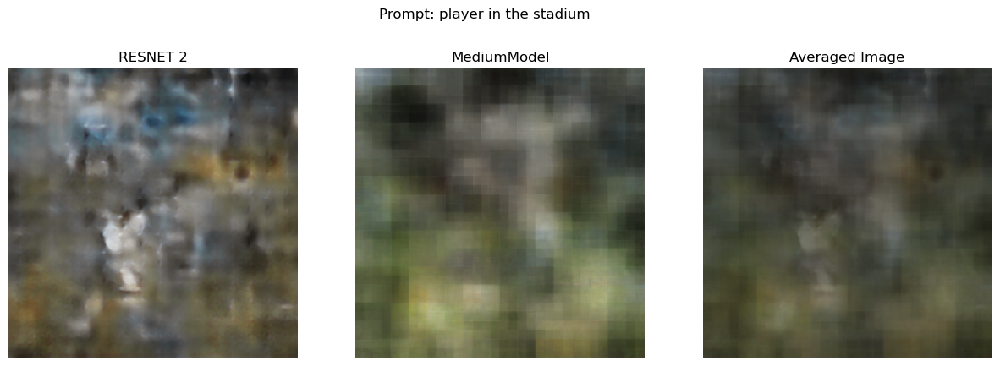

1/1 [==============================] - 0s 45ms/step


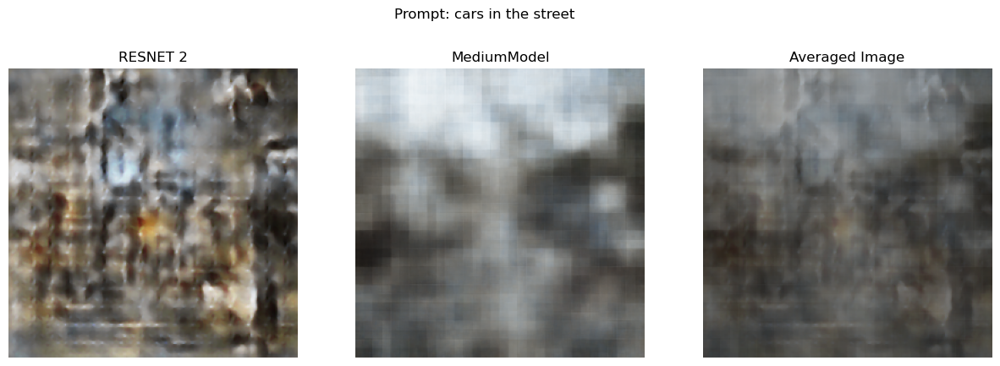

1/1 [==============================] - 0s 47ms/step


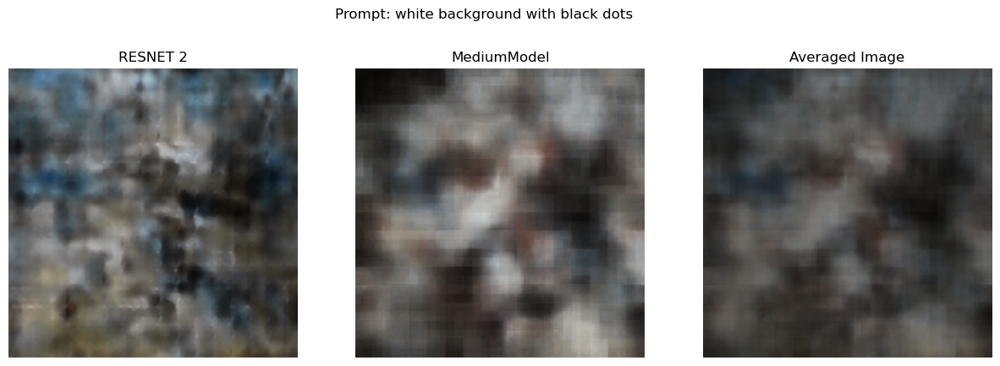

1/1 [==============================] - 0s 45ms/step


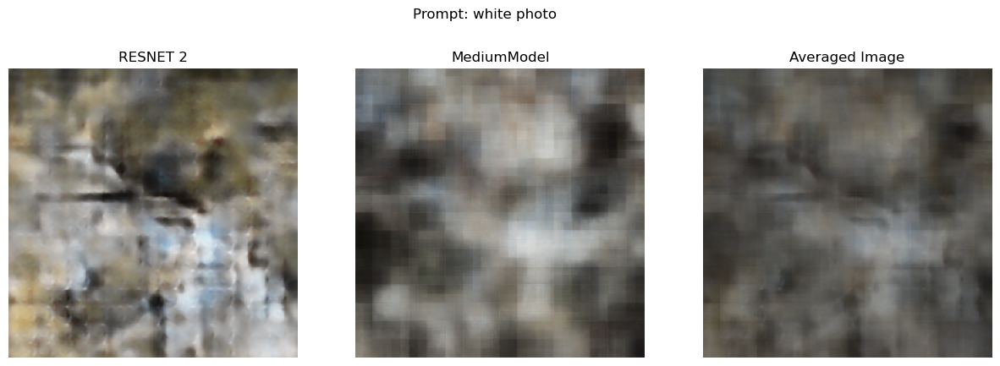

1/1 [==============================] - 0s 50ms/step


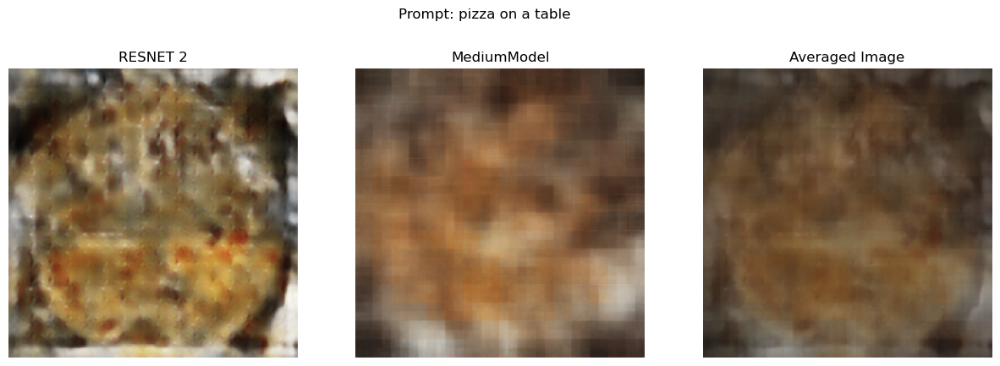

1/1 [==============================] - 0s 46ms/step


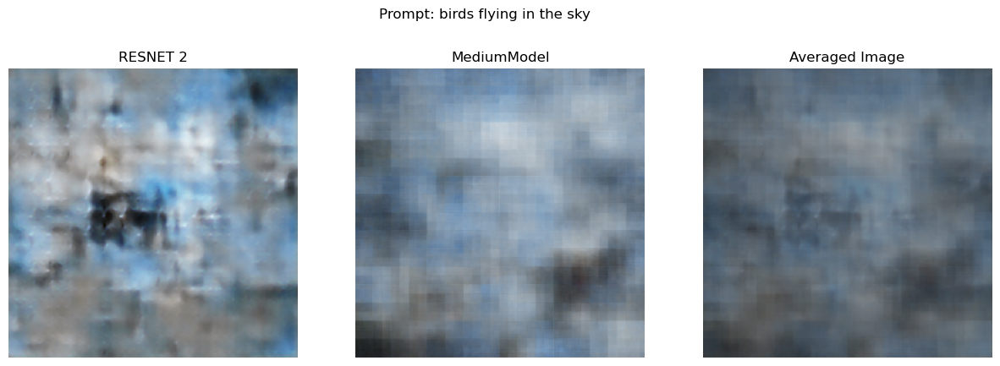

1/1 [==============================] - 0s 45ms/step


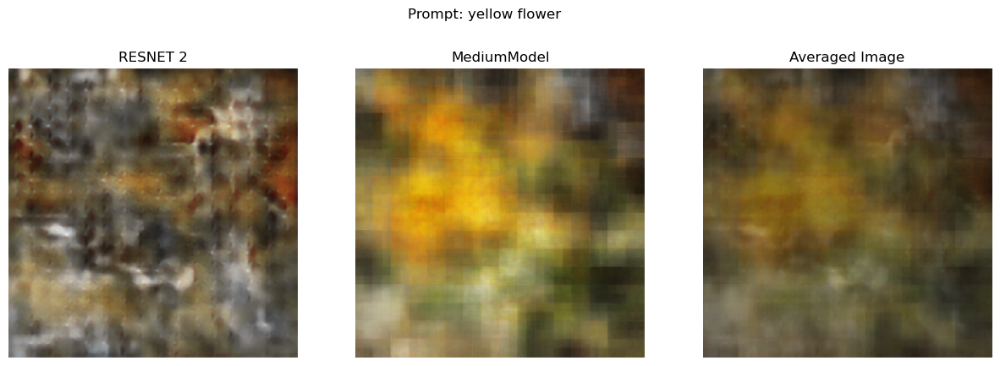

1/1 [==============================] - 0s 45ms/step


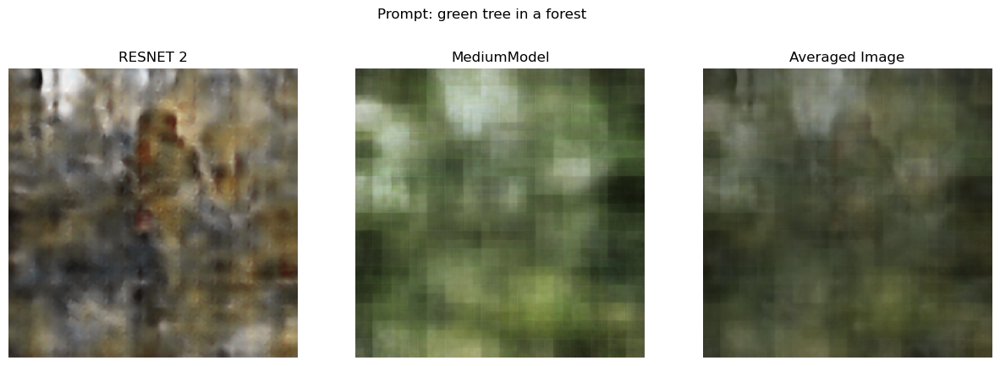

1/1 [==============================] - 0s 52ms/step


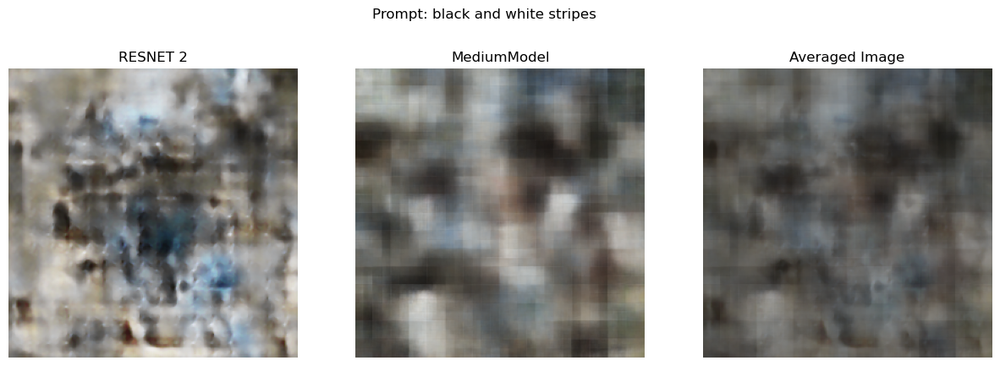

1/1 [==============================] - 0s 46ms/step


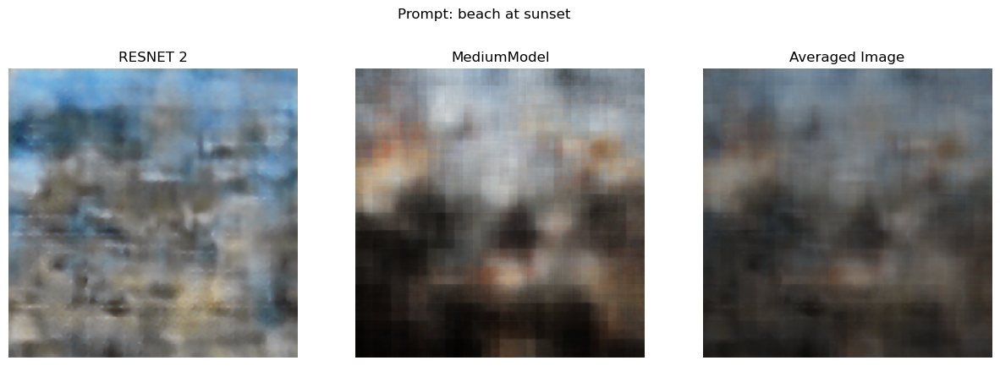

1/1 [==============================] - 0s 50ms/step


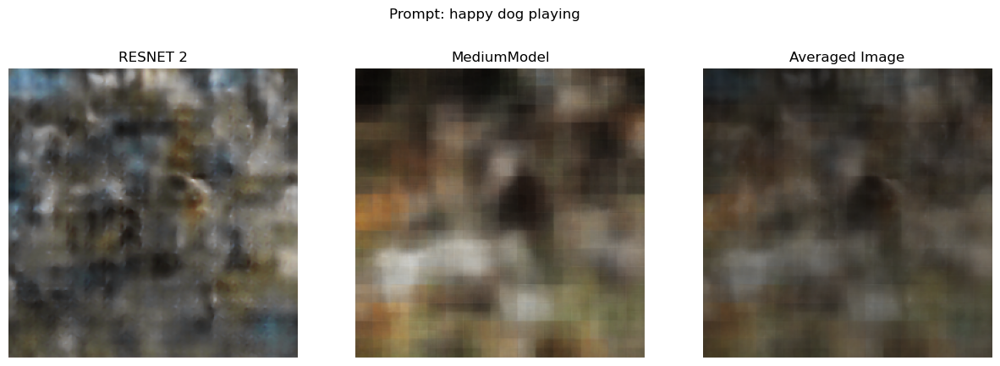

1/1 [==============================] - 0s 47ms/step


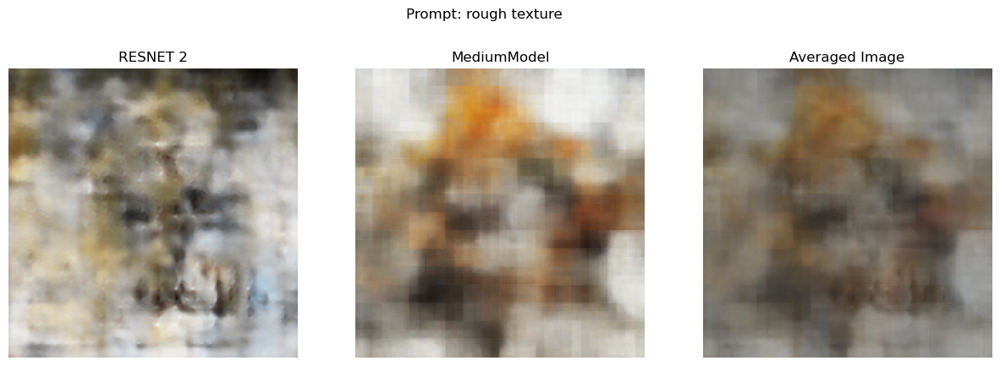

1/1 [==============================] - 0s 49ms/step


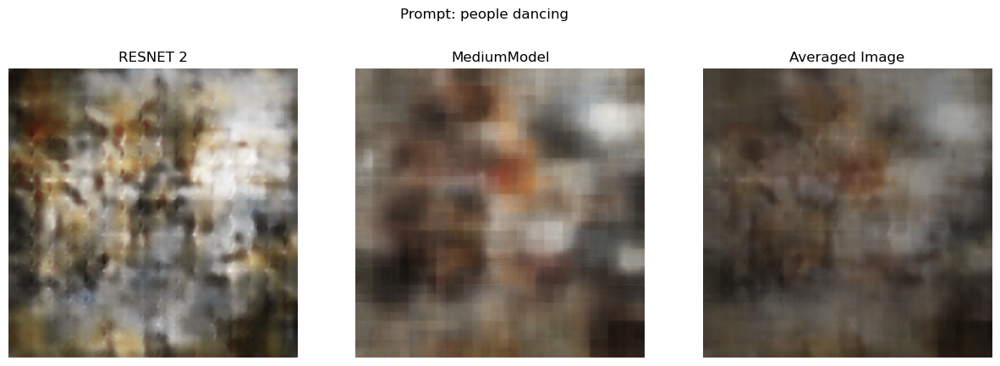

1/1 [==============================] - 0s 50ms/step


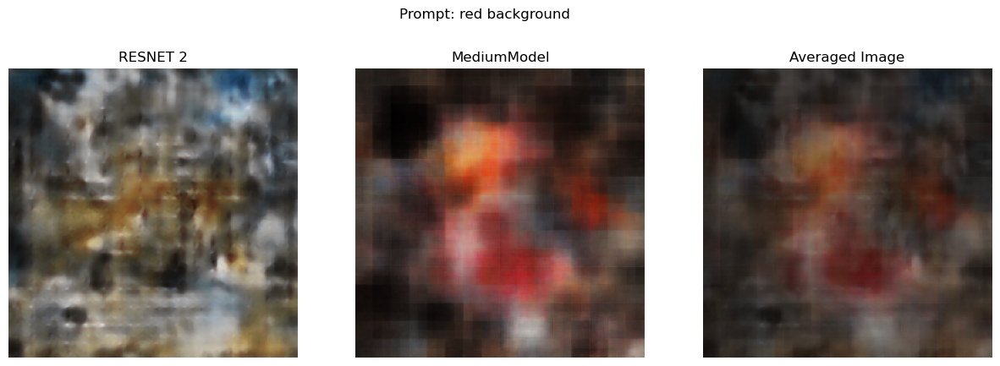

1/1 [==============================] - 0s 45ms/step


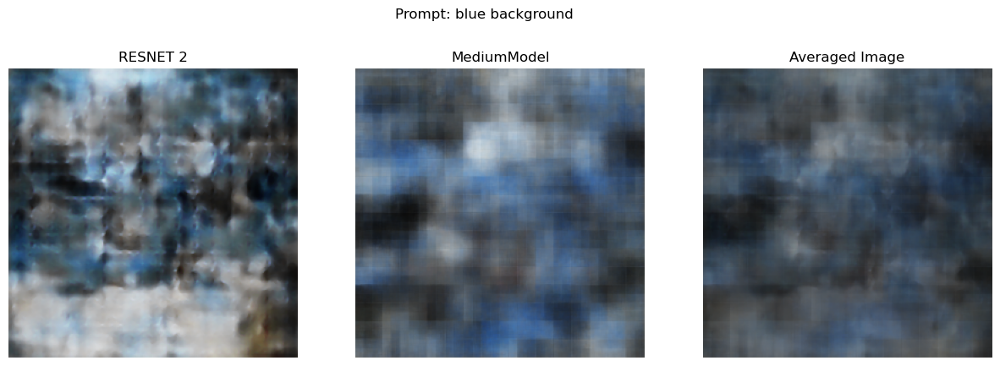

1/1 [==============================] - 0s 45ms/step


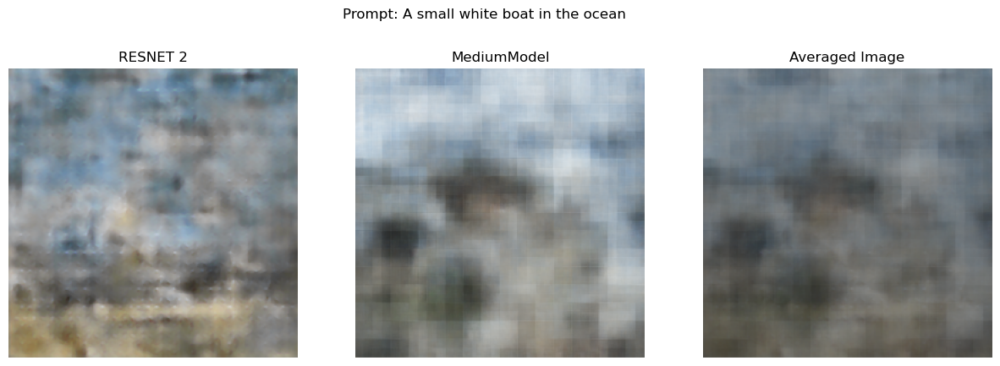

1/1 [==============================] - 0s 46ms/step


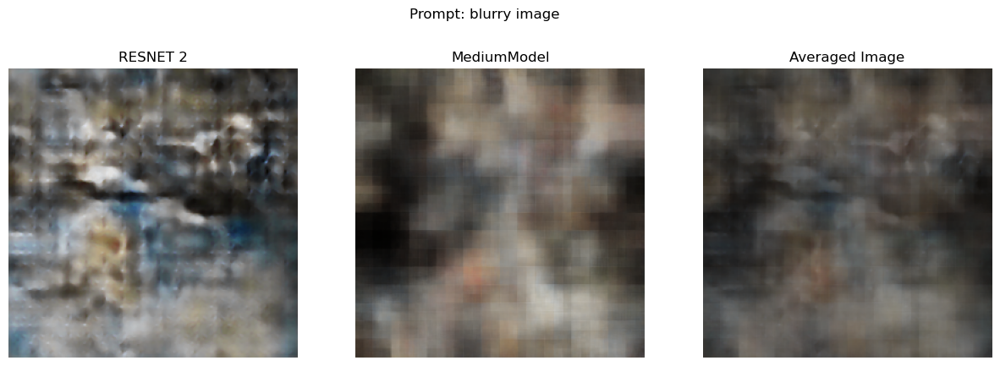

1/1 [==============================] - 0s 46ms/step


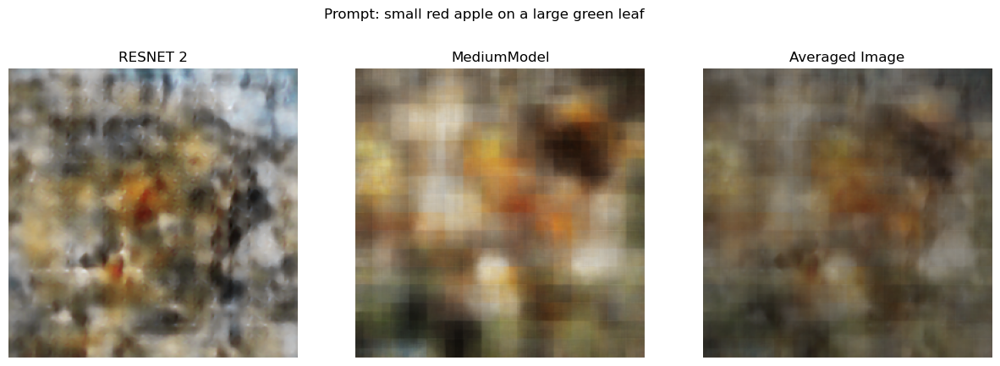

1/1 [==============================] - 0s 47ms/step


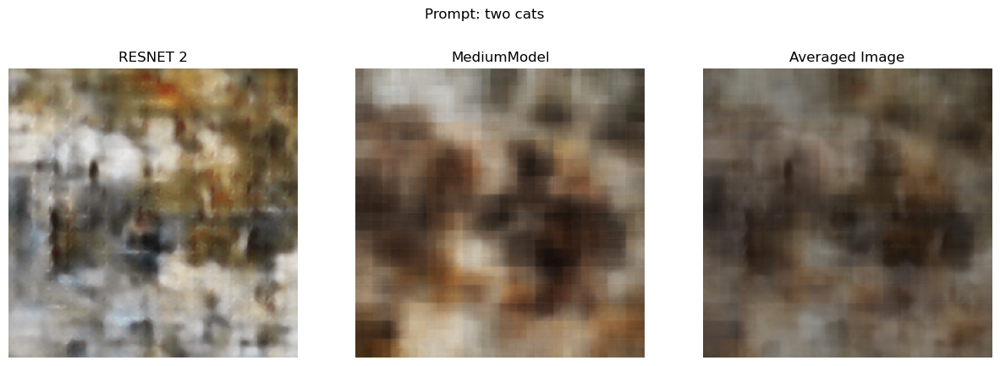

1/1 [==============================] - 0s 47ms/step


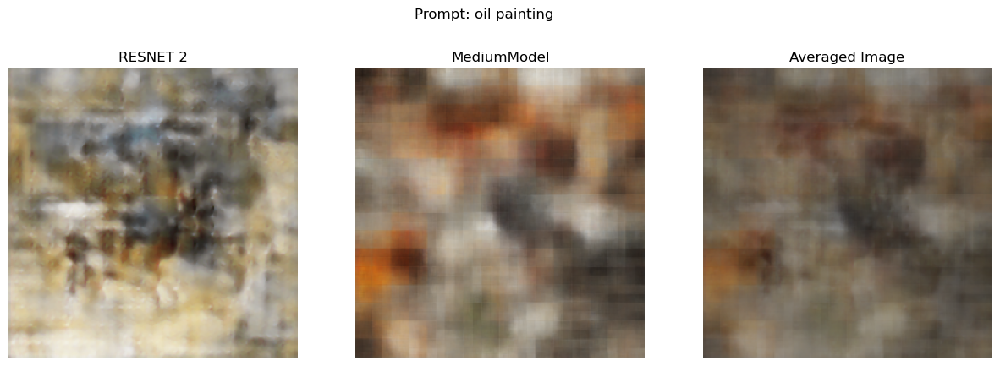

1/1 [==============================] - 0s 45ms/step


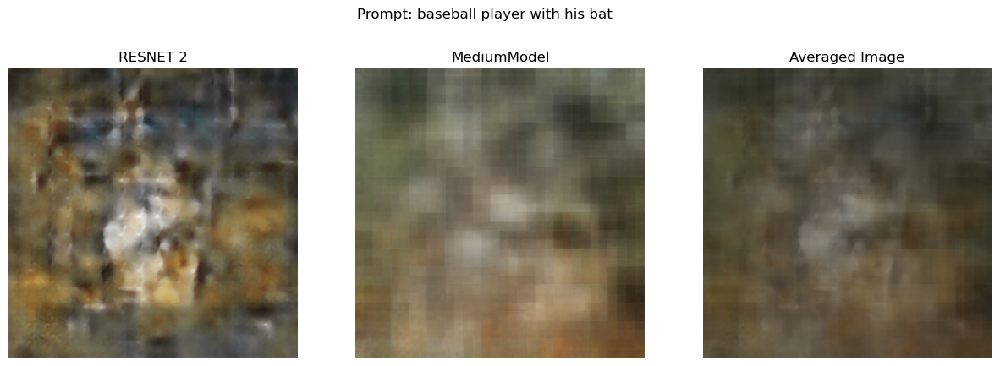

1/1 [==============================] - 0s 48ms/step


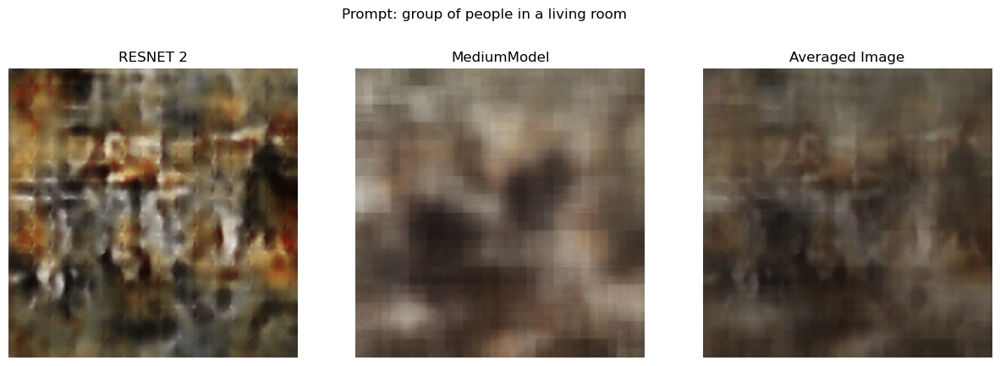

In [12]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from scipy.ndimage import median_filter

# Define  two best models here 
model1 = Resnet_Attn_FPN_2  
model2 = MediumModel 

# List of model names for display
model_names = ['RESNET 2', 'MediumModel', 'Averaged Image']

# List of simple prompts for testing
test_prompts = [
    "player in the stadium",
    "cars in the street",
    "white background with black dots",
    "white photo",
    "pizza on a table",
    "birds flying in the sky",
    "yellow flower",
    "green tree in a forest ",
    "black and white stripes",
    "beach at sunset",
    "happy dog playing",
    "rough texture",
    "people dancing",
    "red background",
    "blue background",
    "A small white boat in the ocean",
    "blurry image",
    "small red apple on a large green leaf",
    "two cats",
    "oil painting",
    "baseball player with his bat",
    "group of people in a living room"   
]

# Loop through each prompt to generate images
for prompt in test_prompts:
    # Preprocess the prompt 
    preprocessed_caption = caption_model.encode([prompt])  # Replace with actual encoding function
    
    # Generate image from model 1 (RESNET 2)
    generated_image_1 = model1.predict(preprocessed_caption)
    generated_image_1 = tf.squeeze(generated_image_1, axis=0)  # Remove batch dimension
    generated_image_1 = (generated_image_1 * 255).numpy().astype(np.uint8)  # Convert to uint8

    # Apply median filter to reduce green noise from generated_image_1
    denoised_image_1 = median_filter(generated_image_1, size=3)  # Apply a median filter with size 3

    # Generate image from model 2 (MediumModel)
    generated_image_2 = model2.predict(preprocessed_caption)
    generated_image_2 = tf.squeeze(generated_image_2, axis=0)  # Remove batch dimension
    generated_image_2 = (generated_image_2 * 255).numpy().astype(np.uint8)  # Convert to uint8

    # Average the pixel values of the denoised image from model 1 and image from model 2
    averaged_image = np.mean([denoised_image_1*0.5, generated_image_2], axis=0).astype(np.uint8)

    # Plotting the images side by side
    plt.figure(figsize=(15, 5))  # Set figure size for displaying images
    
    # Plot image from model 1 (RESNET 2)
    plt.subplot(1, 3, 1)
    plt.imshow(denoised_image_1)  # Display denoised image
    plt.title(model_names[0])
    plt.axis('off')  # Hide axis

    # Plot image from model 2 (MediumModel)
    plt.subplot(1, 3, 2)
    plt.imshow(generated_image_2)
    plt.title(model_names[1])
    plt.axis('off')  # Hide axis

    # Plot averaged image
    plt.subplot(1, 3, 3)
    plt.imshow(averaged_image)
    plt.title(model_names[2])
    plt.axis('off')  # Hide axis

    # Add a common title for the entire figure
    plt.suptitle(f"Prompt: {prompt}")
    
    # Display the images
    plt.show()


## Evaluation of Combined Model Results

### Overview

In this experiment, we combined the two best-performing models from earlier phases: **Resnet_Attn_FPN_2** and **MediumModel**. The goal was to improve image quality by averaging the outputs of these models, leveraging their individual strengths. For each test prompt, images were generated from both models, and the final output was computed by averaging the pixel values of the denoised Resnet model output and the MediumModel output. This approach helps mitigate noise while retaining the details that each model independently captures.

### Process

- **Resnet_Attn_FPN_2**: This model is based on the ResNet architecture with attention mechanisms and Feature Pyramid Networks (FPN), which focus on multi-scale feature extraction. A median filter was applied to the generated images to reduce green noise, a common artifact produced by the model.
  
- **MediumModel**: The MediumModel provides smoother image outputs with less noise, though at times lacks the fine details required to adhere closely to the prompts. It serves as a baseline for generating smoother, more coherent images.
  
- **Averaged Output**: After denoising the image from **Resnet_Attn_FPN_2**, the pixel values of the two images were averaged, providing a balance between the detailed textures of Resnet and the smoothness of MediumModel. This averaging process is intended to combine the best aspects of both models for enhanced visual quality.

### Results

For each prompt, we compared the results from the two models individually and the averaged image:

1. **Resnet_Attn_FPN_2**: Generated images tend to have better structural details due to the attention mechanisms and multi-scale feature extraction from FPN. However, these outputs still suffer from significant noise and color distortions, especially in green regions, which were mitigated using a median filter.
   
2. **MediumModel**: The images produced by this model were smoother and had fewer artifacts, but sometimes lacked the detail and clarity needed for more complex prompts.

3. **Averaged Image**: The averaged images showed improvement over the individual models. The noise was reduced, and the final outputs displayed more consistent colors and clearer object boundaries. However, further refinement is needed, as some images still struggled to fully align with the given prompts.

### Visual Analysis

- **Prompt: "two cats"**: The averaged image retains some of the structure from the Resnet model but with smoother color transitions due to the influence of MediumModel. However, the details of the cats are still not entirely clear.
  
- **Prompt: "player in the stadium"**: The averaged image shows improvements in texture and background clarity. The combination of models helped reduce noise while providing a better overall shape, though the specific elements of the "player" remain unclear.

- **Prompt: "pizza on a table"**: This image shows better contrast and color distribution in the averaged output. The reddish tones representing the pizza became more prominent.

- **Prompt: "yellow flower"**: Averaging improved the appearance of the flower, with clearer color differentiation and better overall structure. The noise and artifacts from Resnet were effectively reduced in this instance, making the averaged image closer to the intended output.

### Conclusion

The combination of the **Resnet_Attn_FPN_2** and **MediumModel** offers a more balanced output compared to each model individually. The **averaged images** benefit from the structural details of Resnet and the smoother textures of MediumModel. While this approach has shown clear improvements in image quality, it still falls short in generating highly detailed, prompt-aligned images. Additional fine-tuning, model training, or architectural adjustments could further enhance performance, especially in complex scenes.



In [14]:
model_path1 = 'mediumModel_Final/model_epoch_1.keras'
model_path2 = 'mediumModel_Final/model_epoch_10.keras'
model_path3 = 'mediumModel_Final/model_epoch_20.keras'
model_path4 = 'mediumModel_Final/model_epoch_30.keras'
model_path5 = 'mediumModel_Final/model_epoch_50.keras'
model_path6 = 'mediumModel_Final/model_epoch_80.keras'
model_path7 = 'mediumModel_Final/model_epoch_100.keras'
model_path8 = 'mediumModel_Final/model_epoch_120.keras'


MediumModel1 = tf.keras.models.load_model(model_path1, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel2 = tf.keras.models.load_model(model_path2, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel3 = tf.keras.models.load_model(model_path3, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel4 = tf.keras.models.load_model(model_path4, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel5 = tf.keras.models.load_model(model_path5, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel6 = tf.keras.models.load_model(model_path6, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel7 = tf.keras.models.load_model(model_path7, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)
MediumModel8 = tf.keras.models.load_model(model_path8, custom_objects={'EnhancedCaptionToImageModel': EnhancedCaptionToImageModel},compile=False)

Models = []
Models.append(MediumModel1)
Models.append(MediumModel2)
Models.append(MediumModel3)
Models.append(MediumModel4)
Models.append(MediumModel5)
Models.append(MediumModel6)
Models.append(MediumModel7)
Models.append(MediumModel8)

print(len(Models))

8


1/1 [==============================] - 0s 123ms/step


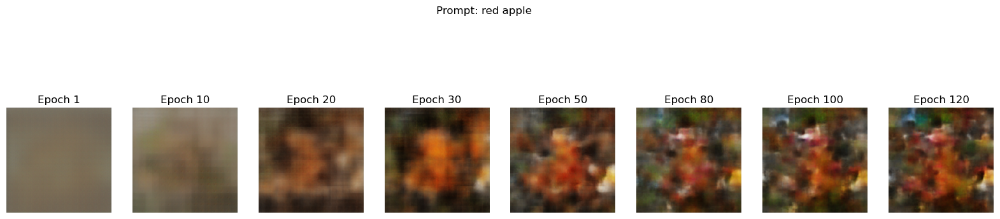

1/1 [==============================] - 0s 54ms/step


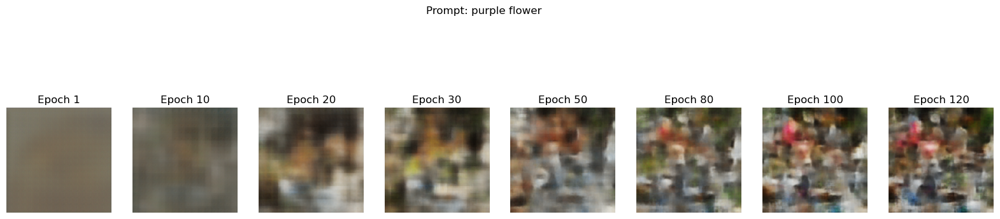

1/1 [==============================] - 0s 45ms/step


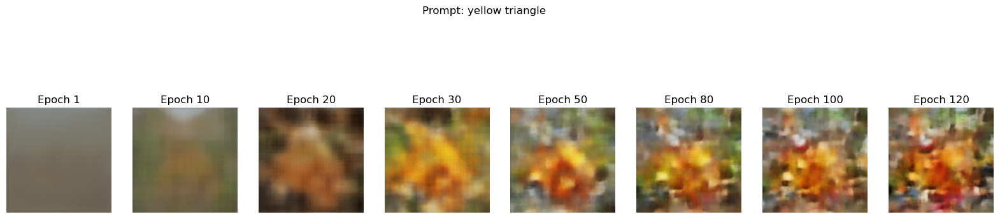

1/1 [==============================] - 0s 44ms/step


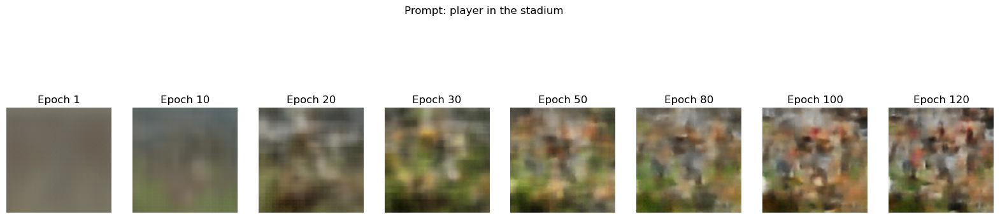

1/1 [==============================] - 0s 51ms/step


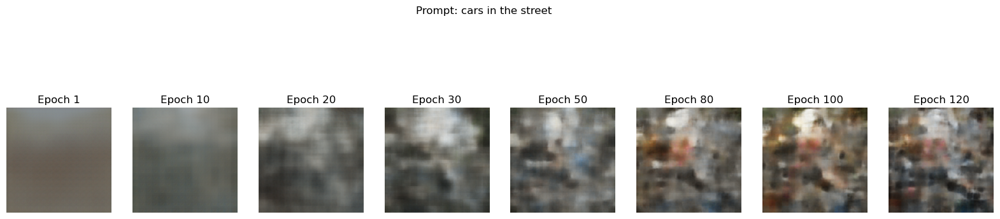

1/1 [==============================] - 0s 47ms/step


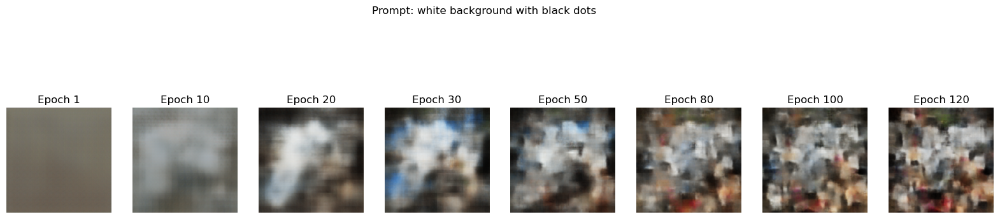

1/1 [==============================] - 0s 50ms/step


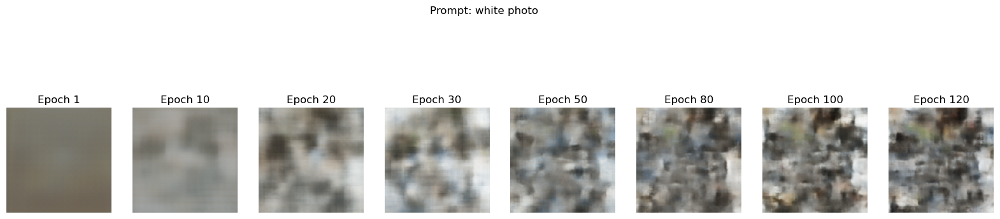

1/1 [==============================] - 0s 45ms/step


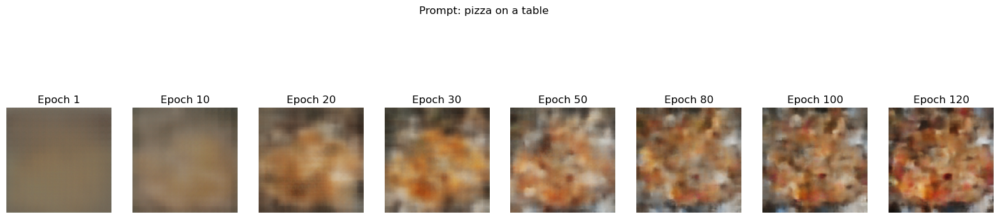

1/1 [==============================] - 0s 46ms/step


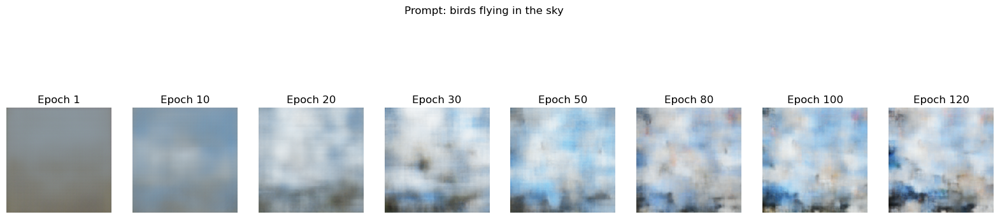

1/1 [==============================] - 0s 48ms/step


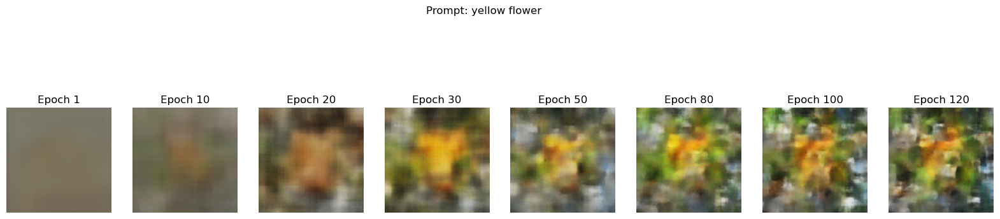

1/1 [==============================] - 0s 47ms/step


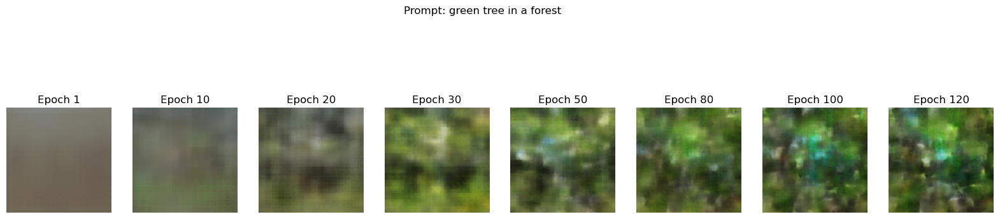

1/1 [==============================] - 0s 47ms/step


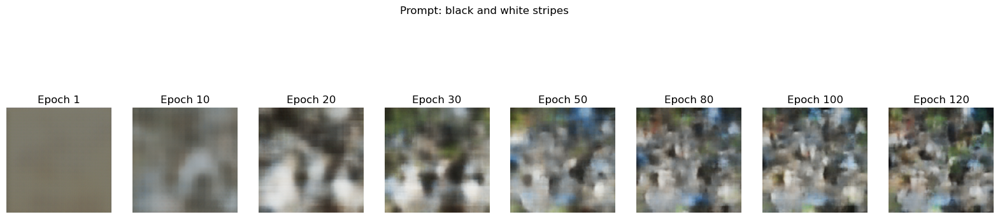

1/1 [==============================] - 0s 45ms/step


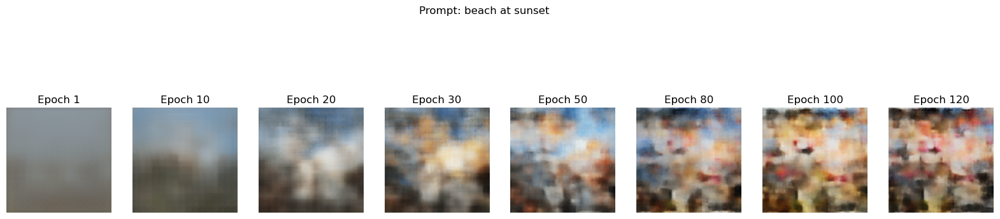

1/1 [==============================] - 0s 46ms/step


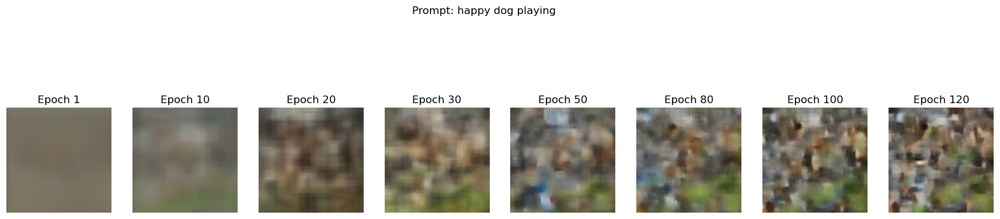

1/1 [==============================] - 0s 45ms/step


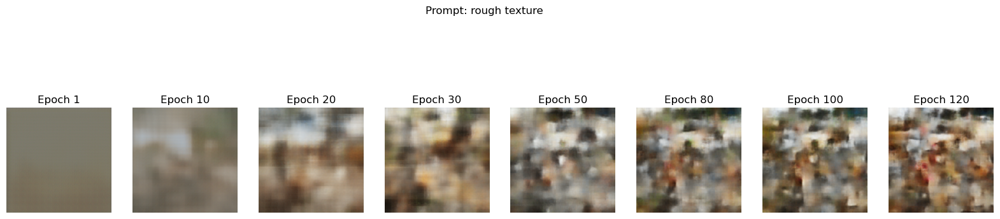

1/1 [==============================] - 0s 47ms/step


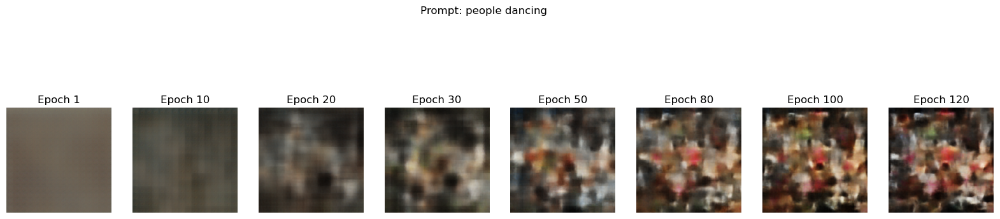

1/1 [==============================] - 0s 48ms/step


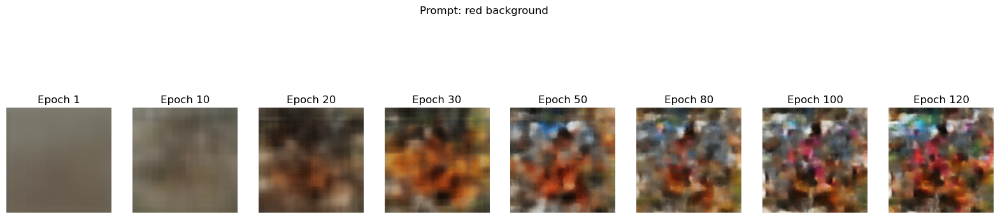

1/1 [==============================] - 0s 46ms/step


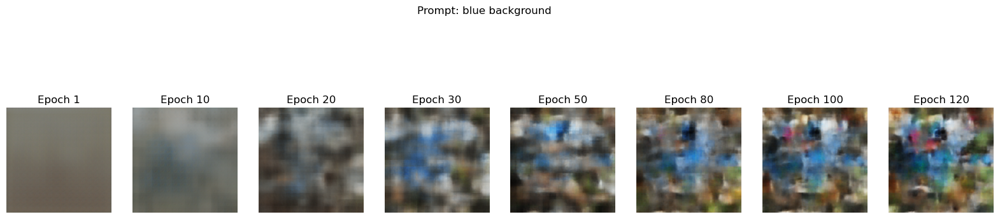

1/1 [==============================] - 0s 52ms/step


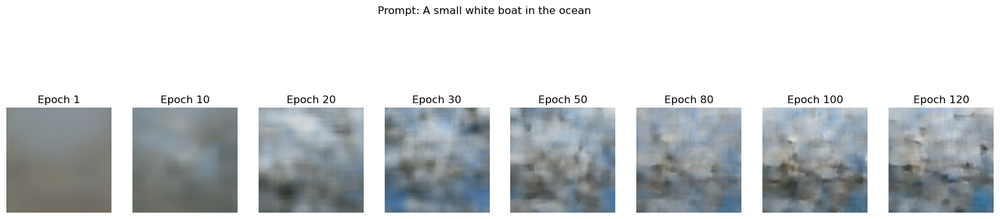

1/1 [==============================] - 0s 45ms/step


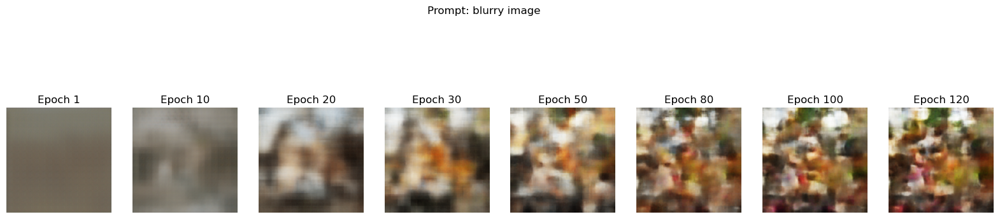

1/1 [==============================] - 0s 48ms/step


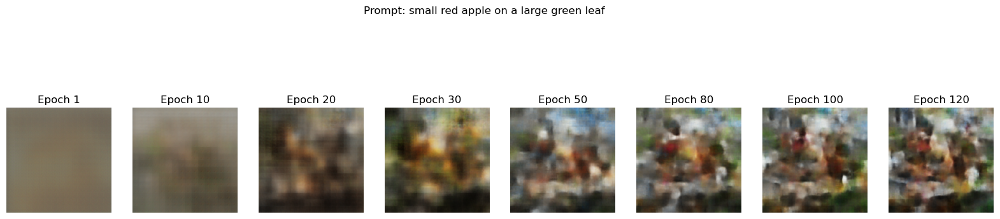

1/1 [==============================] - 0s 44ms/step


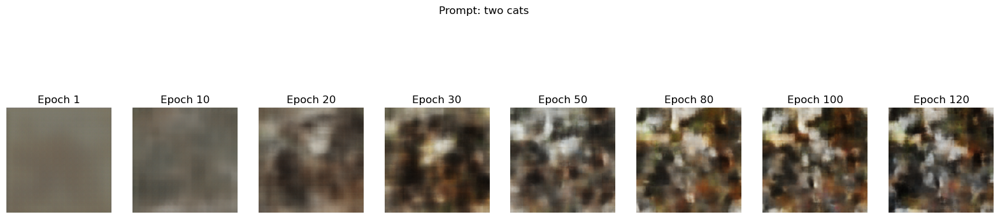

1/1 [==============================] - 0s 46ms/step


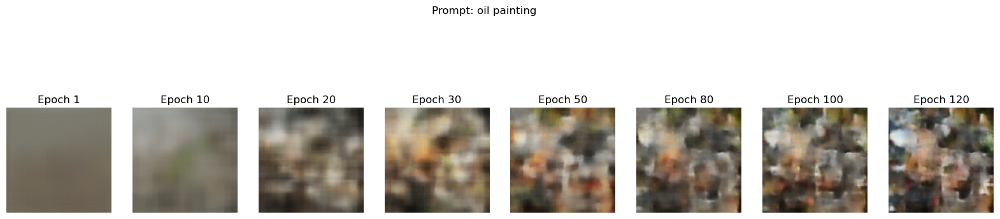

1/1 [==============================] - 0s 45ms/step


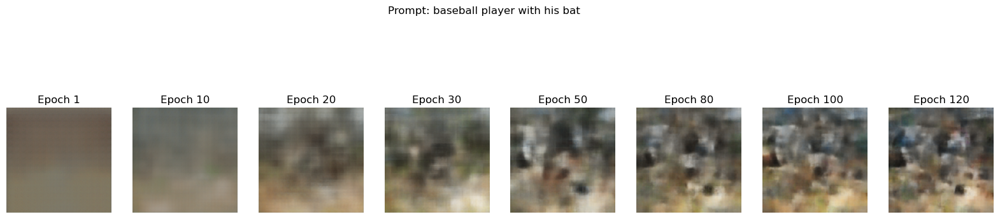

1/1 [==============================] - 0s 47ms/step


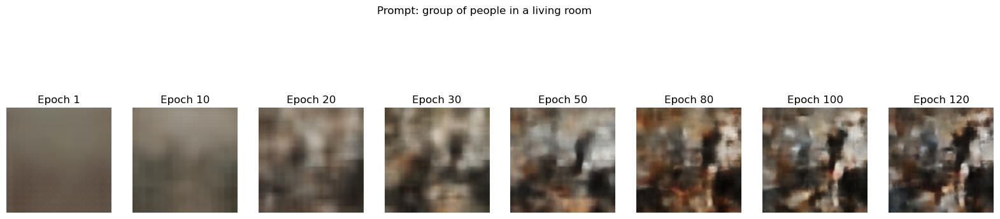

In [15]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# Assume your models are stored in this list
# Models = [model1, model2, model3, model4, model5]  # Replace these with your actual model variables

model_names = ['Epoch 1', 'Epoch 10', 'Epoch 20', 'Epoch 30', 'Epoch 50', 'Epoch 80','Epoch 100','Epoch 120']

# Preprocess the caption function
def preprocess_caption(caption):
    caption_sequence = caption_model.encode([caption])  # Assuming your caption_model encodes text
    return caption_sequence

# List of simple prompts for testing
test_prompts = [
    "red apple",
    "purple flower",
    "yellow triangle",
    "player in the stadium",
    "cars in the street",
    "white background with black dots",
    "white photo",
    "pizza on a table",
    "birds flying in the sky",
    "yellow flower",
    "green tree in a forest ",
    "black and white stripes",
    "beach at sunset",
    "happy dog playing",
    "rough texture",
    "people dancing",
    "red background",
    "blue background",
    "A small white boat in the ocean",
    "blurry image",
    "small red apple on a large green leaf",
    "two cats",
    "oil painting",
    "baseball player with his bat",
    "group of people in a living room"   
]

# Function to generate images from models and display them side by side
def generate_and_plot_images_for_prompt(prompt):
    plt.figure(figsize=(20, 5))  # Set the figure size to accommodate multiple images in one row

    
    for i, model in enumerate(Models):
        # Preprocess the prompt (caption)
        preprocessed_caption = preprocess_caption(prompt)
    
        # Generate an image from the preprocessed caption
        generated_image = model.predict(preprocessed_caption)
    
        # Remove batch dimension (if necessary)
        generated_image = tf.squeeze(generated_image, axis=0)  # Shape should be (28, 28, 3) or appropriate
    
        # Convert the generated image tensor to a format suitable for display
        generated_image = (generated_image * 255).numpy().astype(np.uint8)  # Convert to [0, 255] range and uint8 type
    
        # Display the generated image in a subplot
        plt.subplot(1, len(Models), i + 1)  # 1 row, len(Models) columns, i+1 is the index
        plt.imshow(generated_image)
        plt.title(f"{model_names[i]}")
        plt.axis('off')  # Hide axis labels
    
    plt.suptitle(f"Prompt: {prompt}")  # Add a common title for the prompt
    plt.show()  # Display the row of images

# Loop through each prompt and generate images from all models
for prompt in test_prompts:
    generate_and_plot_images_for_prompt(prompt)


## Evaluation of Final Model Results

### Model Overview
This final model was trained using the same architecture as the **MediumModel**, without the inclusion of Feature Pyramid Networks (FPN) or attention mechanisms. The model was trained on 2.5% of the MS COCO dataset, which included over 14,000 images, for a total of 120 epochs. The learning rate was initially set at **0.0738** and was reduced to **0.0158** by epoch 125. The architecture and training process were intentionally kept simple, as previous attempts with more complex techniques, such as FPN and attention layers, did not yield significantly better results.

### Results Analysis

1. **Prompt: "player in the stadium"**:
   - **Epoch 1 to Epoch 20**: The earlier stages show a highly blurred output, with no discernible features. By epoch 20, some structure begins to emerge, though it is still far from clear.
   - **Epoch 30 to Epoch 50**: The model gradually starts to generate more recognizable features, but the image remains abstract. By epoch 50, more details are visible, particularly the stadium environment, though the "player" remains indistinct.
   - **Epoch 80 to Epoch 120**: The clarity improves steadily as the model progresses. By epoch 100 and 120, the stadium setting becomes somewhat clear, though the player is still not sharply defined. Overall, the image at epoch 120 aligns better with the prompt than the earlier epochs.

2. **Prompt: "pizza on a table"**:
   - **Epoch 1 to Epoch 20**: The image starts off blurred, with vague shapes and no clear indication of the pizza. By epoch 20, the pizza shape starts to emerge.
   - **Epoch 30 to Epoch 50**: As the model trains, the pizza becomes more recognizable, with better color contrast and some detail in the toppings. By epoch 50, the scene is clearer, though still somewhat soft.
   - **Epoch 80 to Epoch 120**: The model generates increasingly realistic results by epoch 80, with distinct features such as the round shape of the pizza and more defined toppings. By epoch 120, the pizza is more sharply defined, with good color accuracy and object clarity.

3. **Prompt: "green tree in a forest"**:
   - **Epoch 1 to Epoch 20**: Initially, the image is heavily blurred, with green hues indicating the presence of trees but no clear structure. By epoch 20, the tree shapes start to emerge.
   - **Epoch 30 to Epoch 50**: By epoch 30, the structure of trees becomes more apparent, and by epoch 50, the image shows a clearer tree in a forest, though still with some blurring in the background.
   - **Epoch 80 to Epoch 120**: At epoch 80, the details improve further, with the tree becoming more distinct, and by epoch 120, the image provides a much clearer representation of the scene, though fine details are still somewhat lacking.

4. **Prompt: "baseball player with his bat"**:
   - **Epoch 1 to Epoch 20**: At the early epochs, the image is very unclear, with no discernible shapes related to the prompt. By epoch 20, some structure begins to appear, but the player and bat are still abstract.
   - **Epoch 30 to Epoch 50**: By epoch 30, a vague shape of the player becomes visible, though still highly blurred. By epoch 50, the form of the player is more recognizable, though the image lacks sharpness.
   - **Epoch 80 to Epoch 120**: As training progresses, the player becomes clearer, especially by epoch 100 and 120. The scene starts to resemble the intended prompt, with better shape definition and clarity, though it still lacks fine detail in the player's form.

5. **Prompt: "group of people in a living room"**:
   - **Epoch 1 to Epoch 20**: The earlier epochs produce very blurry outputs, with only some basic shapes indicating the presence of people. By epoch 20, the general structure of the scene starts to appear, but the people are still not clear.
   - **Epoch 30 to Epoch 50**: By epoch 30, the figures of the people and the living room become more apparent, though still somewhat abstract. By epoch 50, the image becomes clearer, with the group of people more distinguishable.
   - **Epoch 80 to Epoch 120**: By epoch 80, the image is much clearer, with figures of people visible and the setting more recognizable. By epoch 120, the details continue to improve, though the finer aspects of the people are still not fully defined.

6. **Prompt: "yellow triangle"**:
   - **Epoch 1 to Epoch 20**: Initially, the image is very blurry with no discernible shapes. By epoch 20, the yellow triangle starts to become visible, though still abstract.
   - **Epoch 30 to Epoch 50**: By epoch 30, the triangle becomes much more apparent, with the yellow color standing out clearly. By epoch 50, the image is well-defined, with a clearer triangle and surrounding details.
   - **Epoch 80 to Epoch 120**: The triangle becomes sharper and more detailed as the training progresses. By epoch 120, the image provides a clear, distinct triangle with well-defined edges and color contrast.

### Conclusion

This final model, trained for 120 epochs without the complexity of FPN or attention layers, demonstrates a clear improvement over time, particularly for simpler prompts such as "pizza on a table" and "yellow triangle." The more complex prompts, such as "group of people in a living room" and "player in the stadium," still present challenges in generating sharp, detailed images. However, the model performs well given its training data and simplicity.

While the results improve with more epochs, there is clear potential for the model to benefit from the integration of more advanced techniques. Due to the limited time available for this project, these more advanced techniques could not be fully explored. However, with additional research and experimentation, the model’s performance could likely be significantly improved, especially for complex prompts requiring higher contextual understanding and detail.